# **Análisis de Señales EEG para Clasificación de Imaginería Motora con TSFCNet y Técnicas de Interpretabilidad (XAI)**

## **Resumen Ejecutivo**

Este cuaderno presenta un flujo de trabajo completo y profesional para abordar un problema de **Interfaz Cerebro-Computadora (BCI)**. El objetivo es clasificar señales de electroencefalografía (EEG) correspondientes a dos tareas de **imaginería motora**: imaginar el movimiento de la mano izquierda versus la mano derecha.

El proceso se divide en las siguientes etapas clave:
1.  **Configuración del Entorno**: Instalación de librerías especializadas y de uso general.
2.  **Carga y Preprocesamiento Avanzado de Datos**: Se utiliza la base de datos **GIGA-MI-ME** y se aplican técnicas de filtrado y remuestreo para preparar las señales para el modelo.
3.  **Implementación y Entrenamiento del Modelo**: Se utiliza **TSFCNet**, una arquitectura de red neuronal convolucional (CNN) de vanguardia, diseñada específicamente para la decodificación de señales EEG.
4.  **Evaluación del Rendimiento**: Se mide la precisión del modelo en un conjunto de datos de prueba para validar su capacidad de generalización.
5.  **Interpretabilidad y Explicabilidad (XAI)**: Se aplican dos técnicas avanzadas de análisis tiempo-frecuencia para "abrir la caja negra" del modelo. El objetivo es entender qué patrones neurofisiológicos (en qué canales, en qué frecuencias y en qué momentos) está utilizando el modelo para tomar sus decisiones.


### **1. Configuración del Entorno**

Esta primera celda se encarga de instalar todas las dependencias necesarias para la ejecución del cuaderno. Las librerías se agrupan por su funcionalidad:

*   **Repositorios Personalizados (`UN-GCPDS`)**: Contienen herramientas específicas para cargar bases de datos de EEG (`python-gcpds.databases`).
*   **Librerías de Machine Learning y Computación Científica**:
    *   `tensorflow`: El framework principal para construir y entrenar nuestro modelo de Deep Learning.
    *   `scikit-learn`: Utilizado para funciones de preprocesamiento y evaluación, como la división de datos.
    *   `mne`: La librería estándar de oro en la comunidad de neurociencia para el análisis y visualización de datos de M/EEG.
    *   `PyWavelets`: Necesaria para el análisis tiempo-frecuencia mediante la Transformada Wavelet Continua (CWT).
    *   `tqdm`: Proporciona barras de progreso para monitorear bucles largos.

In [1]:
%%capture
# --- Repositorios personalizados para datos y modelos ---
!pip install -U git+https://github.com/UN-GCPDS/python-gcpds.databases
!pip install -U git+https://github.com/UN-GCPDS/python-gcpds.visualizations.git >/dev/null
!pip install -U git+https://github.com/UN-GCPDS/python-gcpds.EEG_Tensorflow_models@Marcos-L-patch-1

# --- Librerías estándar de Machine Learning y ciencia de datos ---
!pip install -U keras==3.2.1
!pip install -U tensorflow
!pip install -U tf_keras
!pip install -U shap
!pip install -U mne
!pip install -U PyWavelets
!pip install -U tqdm
!pip install -U matplotlib

### **2. Importación de Módulos Centralizados**

Una vez instaladas, importamos todas las funciones y clases que utilizaremos a lo largo del script. Centralizar las importaciones es una buena práctica que mejora la legibilidad y el mantenimiento del código.

Se agrupan de la siguiente manera:
*   **Ciencia de Datos y Procesamiento de Señales**: `numpy` para operaciones numéricas, `mne` para análisis neurofisiológico, `pywt` para wavelets, y `scipy.signal` para filtrado y remuestreo.
*   **TensorFlow y Creación del Modelo**: Componentes de `tensorflow.keras` para definir la arquitectura de la red neuronal.
*   **Carga de Datos y Visualización**: Módulos para interactuar con la base de datos y generar gráficos.
*   **Utilidades**: `gc` (Garbage Collector) para gestionar la memoria en operaciones intensivas.

In [2]:
# ===============================================================
# 2.1. LIBRERÍAS DE CIENCIA DE DATOS Y PROCESAMIENTO DE SEÑALES
# ===============================================================
import numpy as np
from tqdm import tqdm
import pywt
import mne
from scipy.signal import butter as bw, filtfilt, resample
from sklearn.model_selection import train_test_split
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.metrics import cohen_kappa_score

# ===============================================================
# 2.2. TENSORFLOW Y CREACIÓN DEL MODELO
# ===============================================================
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import (Input, Conv2D, BatchNormalization, DepthwiseConv2D, 
                                     Activation, AveragePooling2D, Dropout, 
                                     SeparableConv2D, Flatten, Dense, SpatialDropout2D)
from tensorflow.keras.constraints import max_norm
from tensorflow.keras.utils import to_categorical
from tensorflow.keras import layers, Model, constraints, Input
from tensorflow.keras.utils import register_keras_serializable

# ===============================================================
# 2.3. CARGA DE DATOS
# ===============================================================
from gcpds.databases import GIGA_MI_ME

# ===============================================================
# 2.4. VISUALIZACIÓN Y OTRAS UTILIDADES
# ===============================================================
import matplotlib.pyplot as plt
import io
from matplotlib.cm import ScalarMappable
from matplotlib.colors import Normalize
import gc # Garbage Collector para liberar memoria explícitamente

# ===============================================================
# 2.5. VERIFICACIÓN DE VERSIONES
# ===============================================================
print("Librerías esenciales cargadas correctamente.")
print(f"Versión de MNE: {mne.__version__}")
print(f"Versión de TensorFlow: {tf.__version__}")
print(f"Versión de PyWavelets: {pywt.__version__}")

2025-07-22 15:37:04.348893: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:467] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1753198624.376475      18 cuda_dnn.cc:8579] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1753198624.384756      18 cuda_blas.cc:1407] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
W0000 00:00:1753198624.407132      18 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking the same target more than once.
W0000 00:00:1753198624.407169      18 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking the same target more than once.
W0000 00:00:1753198624.407172      18 computation_placer.cc:177] computation placer alr

Librerías esenciales cargadas correctamente.
Versión de MNE: 1.10.0
Versión de TensorFlow: 2.19.0
Versión de PyWavelets: 1.8.0


### **3. Definiciones, Constantes y Funciones Auxiliares**

Esta sección contiene el "cerebro" de nuestro pipeline: las definiciones de constantes y las funciones personalizadas que encapsulan la lógica de preprocesamiento y la arquitectura del modelo.

#### **3.1. Definiciones de Canales**
Se define una lista con los nombres de los 64 canales de EEG utilizados, siguiendo el sistema internacional 10-20. Esta lista es fundamental para la correcta selección de datos y para la posterior visualización topográfica.

In [3]:
channels = ['Fp1','Fpz','Fp2', 'AF7','AF3','AFz','AF4','AF8',
            'F7','F5','F3','F1','Fz','F2','F4','F6','F8', 'FT7',
            'FC5','FC3','FC1','FCz','FC2','FC4','FC6','FT8',
            'T7','C5','C3','C1','Cz','C2','C4','C6','T8', 'TP7',
            'CP5','CP3','CP1','CPz','CP2','CP4','CP6','TP8', 'P9',
            'P7','P5','P3','P1','Pz','P2','P4','P6','P8','P10',
            'PO7','PO3','POz','PO4','PO8', 'O1','Oz','O2', 'Iz']

#### **3.2. Funciones de Preprocesamiento de Señal**

*   **`butterworth_digital_filter`**: Implementa un filtro Butterworth, que es ideal por su respuesta de frecuencia plana en la banda de paso. Se utiliza `filtfilt` (filtrado de fase cero) para aplicar el filtro hacia adelante y hacia atrás, lo que evita introducir desfases temporales en la señal, un aspecto crítico en el análisis de EEG.

*   **`TimeFrequencyRpr`**: Una clase de preprocesamiento compatible con `scikit-learn` (`BaseEstimator`, `TransformerMixin`) que aplica secuencialmente un banco de filtros (para aislar bandas de frecuencia de interés) y extrae ventanas de tiempo relevantes de la señal.

*   **`load_GIGA`**: Función de alto nivel que orquesta todo el proceso de carga para un sujeto específico de la base de datos GIGA.
    1.  Selecciona los canales EEG correctos.
    2.  Utiliza `TimeFrequencyRpr` para filtrar la señal (ej. 4-40 Hz) y seleccionar el segmento de tiempo de interés (ej. 2.5s a 5s post-estímulo).
    3.  Remuestrea (`resample`) la señal a una frecuencia de muestreo más baja (ej. 250 Hz) para reducir la carga computacional sin perder información relevante para la tarea.

In [4]:
def butterworth_digital_filter(X, N, Wn, btype, fs, axis=-1, padtype=None, padlen=0, method='pad', irlen=None):
    b, a = bw(N, Wn, btype, analog=False, output='ba', fs=fs)
    return filtfilt(b, a, X, axis=axis, padtype=padtype, padlen=padlen, method=method, irlen=irlen)

class TimeFrequencyRpr(BaseEstimator, TransformerMixin):
    # (El código de la clase se mantiene como en el original)
    def __init__(self, sfreq, f_bank=None, vwt=None):
        self.sfreq, self.f_bank, self.vwt = sfreq, f_bank, vwt
    def _validation_param(self): # ... (validación de parámetros)
        if self.sfreq <= 0: raise ValueError('Non negative sampling frequency is accepted')
        if self.f_bank is None: self.flag_f_bank = False
        elif self.f_bank.ndim != 2: raise ValueError('Band frequencies have to be a 2D array')
        else: self.flag_f_bank = True
        if self.vwt is None: self.flag_vwt = False
        elif self.vwt.ndim != 2: raise ValueError('Time windows have to be a 2D array')
        else: self.flag_vwt = True
    def _filter_bank(self, X): # ... (aplicación del filtro)
        X_f = np.zeros((X.shape[0], X.shape[1], X.shape[2], self.f_bank.shape[0]))
        for f in range(self.f_bank.shape[0]):
            X_f[:, :, :, f] = butterworth_digital_filter(X, N=5, Wn=self.f_bank[f], btype='bandpass', fs=self.sfreq)
        return X_f
    def _sliding_windows(self, X): # ... (extracción de ventanas)
        window_lenght = int(self.sfreq * self.vwt[0, 1] - self.sfreq * self.vwt[0, 0])
        X_w = np.zeros((X.shape[0], X.shape[1], window_lenght, self.vwt.shape[0]))
        for w in range(self.vwt.shape[0]):
            X_w[:, :, :, w] = X[:, :, int(self.sfreq * self.vwt[w, 0]):int(self.sfreq * self.vwt[w, 1])]
        return X_w
    def fit(self, X, y=None): pass
    def transform(self, X, y=None): # ... (orquestación del transformado)
        self._validation_param()
        if self.flag_f_bank: X_f = self._filter_bank(X)
        else: X_f = X[:, :, :, np.newaxis]
        if self.flag_vwt:
            X_wf = [self._sliding_windows(X_f[:, :, :, f]) for f in range(X_f.shape[3])]
            X_wf = np.stack(X_wf, axis=-1)
        else: X_wf = X_f[:, :, :, np.newaxis, :]
        return X_wf

def load_GIGA(db, sbj, eeg_ch_names, fs, f_bank, vwt, new_fs, run=None):
    index_eeg_chs = db.format_channels_selectors(channels = eeg_ch_names) - 1
    tf_repr = TimeFrequencyRpr(sfreq = fs, f_bank = f_bank, vwt = vwt)
    db.load_subject(sbj)
    if run is None: X, y = db.get_data(classes = ['left hand mi', 'right hand mi'])
    else: X, y = db.get_run(run, classes = ['left hand mi', 'right hand mi'])
    X = X[:, index_eeg_chs, :]
    X = np.squeeze(tf_repr.transform(X))
    if new_fs != fs:
        print(f"Remuestreando señal de {fs:.2f} Hz a {new_fs:.2f} Hz.")
        X = resample(X, int((X.shape[-1]/fs)*new_fs), axis = -1)
    return X, y

#### **Definición del Modelo: `TSFCNet` con `Center Loss`**

Esta función construye el modelo `TSFCNet_Explicit_Fixed_Center`, una arquitectura de red neuronal avanzada diseñada para la clasificación de datos EEG en formato tiempo-frecuencia. Su principal fortaleza radica en la extracción paralela de características y en el uso de `Center Loss` para mejorar la discriminación.

El modelo se compone de los siguientes bloques principales:

*   **Bloque de Entrada y `MixConv` (Convoluciones Mixtas)**:
    *   **Entradas**: El modelo requiere dos entradas: los datos EEG (`eeg_in`) y las etiquetas de clase (`label_in`), estas últimas son esenciales para la capa `Center Loss`.
    *   **`MixConv`**: Actúa como un banco de filtros temporales inteligentes.
        *   **`Lambda` (con `make_slice_fn`)**: Divide el tensor de entrada a lo largo del eje de las bandas de frecuencia en varios grupos.
        *   **`DepthwiseConv2D`**: Aplica convoluciones temporales con kernels de diferentes tamaños a cada grupo. Esto permite al modelo capturar simultáneamente patrones EEG de corta y larga duración.
        *   **`Add` (Conexión Residual)**: Combina la salida de las convoluciones con la entrada original para estabilizar el entrenamiento y mejorar el flujo de gradientes.

*   **Ramas Paralelas de Extracción de Características**: La salida de `MixConv` se procesa simultáneamente a través de tres ramas especializadas:
    *   **Rama Espacial (`spa`)**:
        *   **`Conv2D` con kernel `(C, 1)`**: Actúa como un filtro espacial, aprendiendo a combinar la información de todos los canales de EEG para capturar la topografía de la actividad cerebral.
    *   **Rama Frecuencial (`fre`)**:
        *   **`Permute`**: Reordena los ejes del tensor para que las bandas de frecuencia puedan ser procesadas.
        *   **`Conv2D` con kernel `(Nf, 1)`**: Funciona como un filtro espectral, aprendiendo patrones y relaciones entre las diferentes bandas de frecuencia.
    *   **Rama Tiempo-Frecuencia (`tfm`)**:
        *   **`Conv2D` con kernel `(2, 16)`**: Captura patrones locales y texturas en el mapa tiempo-frecuencia.
        *   **`GlobalAveragePooling2D`**: Resume la información espacial y temporal del mapa de características en un vector compacto.

*   **Módulo de Reducción de Varianza (Común a las tres ramas)**:
    *   **`Lambda` (con `variance_fn`)**: Un paso clave de reducción de dimensionalidad. En lugar de un simple aplanado (`Flatten`), calcula la varianza de las características a lo largo del eje temporal. Esto produce una representación más robusta y estadísticamente significativa de la "energía" o "dispersión" de la actividad aprendida en cada rama.

*   **Bloque de Fusión y Clasificación con `Center Loss`**:
    *   **`Concatenate`**: Une los vectores de características de las tres ramas (espacial, frecuencial y tiempo-frecuencia) en un único vector multimodal.
    *   **`CenterLossLayer`**: Esta es la capa de innovación principal.
        *   **Objetivo**: No solo separar las clases, sino también hacer que las características de una misma clase sean lo más compactas y cercanas posible a un "centro" aprendible.
        *   **Funcionamiento**: Calcula una pérdida adicional (`Center Loss`) basada en la distancia de cada muestra a su centro de clase correspondiente. Esta pérdida se suma a la pérdida de clasificación principal, forzando al modelo a aprender representaciones internas más discriminativas.
        *   **`@tf.custom_gradient`**: Permite definir manualmente cómo fluyen los gradientes para actualizar tanto las características del modelo como las posiciones de los centros.
    *   **`Dense` (Clasificador)**: El vector de características, ahora optimizado y más robusto gracias a `Center Loss`, se pasa a una capa densa final con activación `softmax` para generar la predicción de clase.

Esta arquitectura híbrida es excepcionalmente potente, ya que combina la extracción de características multimodales con técnicas de aprendizaje de métricas (`Center Loss`) para crear un clasificador de EEG altamente robusto y preciso.

In [5]:
@register_keras_serializable()
def variance_fn(t):
    return tf.reduce_mean(tf.square(t - tf.reduce_mean(t, axis=-1, keepdims=True)), axis=-1)

@register_keras_serializable()
def variance_output_shape(input_shape):
    return (input_shape[0], input_shape[1], input_shape[2])

def make_slice_fn(start, end):
    @register_keras_serializable()
    def slice_tensor(x):  return x[:, start:end, :, :]
    @register_keras_serializable()
    def slice_shape(inp): return (inp[0], end-start, inp[2], inp[3])
    return slice_tensor, slice_shape

class CenterLossLayer(tf.keras.layers.Layer):
    """
    Center Loss 100 % equivalente a tu implementación PyTorch:
      • self.centers es trainable (lr controla la “α” implícita)
      • loss = ½ Σ‖f_i − c_{y_i}‖² / B   (size_average=True)
      • grad_centers = Σ(diff) / (count_k · B)
    """
    def __init__(self, num_classes, feat_dim,
                 lambda_center=1e-3,  # ← sin parámetro seed
                 **kw):
        super().__init__(**kw)

        # Centros inicializados con una distribución Normal(0,1)
        self.centers = tf.Variable(
            initial_value=tf.random.normal(shape=(num_classes, feat_dim),
                                           mean=0.0, stddev=1.0),
            trainable=True,
            name="centers",
        )
        self.num_classes = num_classes
        self.feat_dim = feat_dim
        self.lambda_center = lambda_center

    # ----------------- núcleo con gradiente custom -----------------
    @tf.custom_gradient
    def _loss_and_grad(self, feats, labels, centers, batch_size_f):
        centers_b = tf.gather(centers, labels)               # (B,d)
        diff = feats - centers_b
        loss = 0.5 * tf.reduce_sum(tf.square(diff)) / batch_size_f

        def grad(dy=1.0):                                    # dy = upstream
            grad_feats = dy * diff / batch_size_f * (-1.0)

            # --- grad wrt centers --------------------------------
            counts = tf.math.unsorted_segment_sum(
                tf.ones_like(labels, dtype=centers.dtype),
                labels, num_segments=self.num_classes)              # (C,)
            counts = tf.reshape(counts, (-1, 1))                    # (C,1)

            grad_cent = tf.math.unsorted_segment_sum(
                -diff, labels, num_segments=self.num_classes)       # (C,d)
            grad_cent = grad_cent / counts                          # ÷ count_k
            grad_cent = dy * grad_cent / batch_size_f               # ÷ B

            return grad_feats, tf.zeros_like(labels), grad_cent, None

        return loss, grad

    def call(self, labels, feats):
        # Aplana a (B, d)
        feats = tf.reshape(feats, (-1, self.feat_dim))

        # --------- VALIDACIÓN segura ---------
        static_d = feats.shape[-1]          # puede ser None al construir el grafo
        if static_d is not None and static_d != self.feat_dim:
            raise ValueError(f"Feat dim {static_d} ≠ {self.feat_dim}")

        bsz_f = tf.cast(tf.shape(feats)[0], tf.float32)

        loss = self._loss_and_grad(feats,
                                   tf.cast(labels, tf.int32),
                                   self.centers,
                                   bsz_f)
        self.add_loss(self.lambda_center * loss)
        return feats        # regresan features sin variar


# ──────────────────────────────
# TU TSFCNet + Center Loss
# ──────────────────────────────
def build_tsfcnet_explicit_fixed_center(
        input_shape=(9, 64, 1000), num_classes=2,
        m_kernels=9, K=10, k_sizes=(15, 31, 63, 125),
        lambda_center=1e-3):

    # Entradas
    eeg_in   = Input(shape=input_shape, name="eeg")            # (B,Nf,C,T)
    label_in = Input(shape=(), dtype="int32", name="labels")   # (B,)

    Nf, C, T = input_shape
    x = eeg_in

    # ---------------- MIXCONV (igual) ----------------
    base, rem = divmod(Nf, len(k_sizes))
    grp_sizes = [base + (i < rem) for i in range(len(k_sizes))]
    taps, start = [], 0
    for i, (g_sz, k_sz) in enumerate(zip(grp_sizes, k_sizes)):
        end = start + g_sz
        slice_fn, slice_shape = make_slice_fn(start, end)
        seg = layers.Lambda(slice_fn, output_shape=slice_shape,
                            name=f"mixconv_slice_{i}")(x)
        conv = layers.DepthwiseConv2D(
            (1, k_sz), padding="same", data_format="channels_first",
            depthwise_initializer="he_normal", depthwise_constraint= constraints.max_norm(0.5), name=f"mixconv_dw_{i}")(seg)
        taps.append(layers.Identity(name=f"tap_dw_{i}")(conv))
        start = end
    x = layers.Add(name="mixconv_residual")([x,
         layers.Concatenate(axis=1, name="mixconv_concat")(taps)])

    # ---------------- Rama espacial ----------------
    spa = layers.Conv2D(m_kernels, (C,1), padding="valid",
                        data_format="channels_first", use_bias=False,
                        kernel_initializer="he_normal", kernel_constraint=constraints.max_norm(0.5),name="conv_spa")(x)
    spa = layers.BatchNormalization(axis=1)(spa);  spa = layers.ELU()(spa)
    spa = layers.Reshape((-1, K, spa.shape[-1]//K), name="reshape_spa")(spa)
    spa = layers.Lambda(variance_fn, output_shape=variance_output_shape,
                        name="var_spatial")(spa)
    spa = layers.Dropout(0.5)(spa)
    spa = layers.Flatten(name="flatten_spatial")(spa)

    # ---------------- Rama frecuencia ----------------
    freq_in = layers.Permute((2,1,3), name="perm_freq")(x)      # (B,C,Nf,T)
    fre = layers.Conv2D(m_kernels, (Nf,1), padding="valid",
                        data_format="channels_first", use_bias=False,
                        kernel_initializer="he_normal", kernel_constraint=constraints.max_norm(0.5),name="conv_freq")(freq_in)
    fre = layers.BatchNormalization(axis=1)(fre); fre = layers.ELU()(fre)
    fre = layers.Reshape((-1, K, fre.shape[-1]//K),
                         name="reshape_freq")(fre)
    fre = layers.Lambda(variance_fn, output_shape=variance_output_shape,
                        name="var_freq")(fre)
    fre = layers.Dropout(0.5)(fre)
    fre = layers.Flatten(name="flatten_freq")(fre)

    # ---------------- Rama tiempo-frecuencia ----------------
    tfm = layers.Conv2D(m_kernels, (2,16), padding="valid",
                        data_format="channels_first", use_bias=False,
                        kernel_initializer="he_normal", kernel_constraint=constraints.max_norm(0.5),name="conv_tf")(freq_in)
    tfm = layers.BatchNormalization(axis=1)(tfm);  tfm = layers.ELU()(tfm)
    tfm = layers.GlobalAveragePooling2D(data_format="channels_first",
                                        name="avgpool_tf")(tfm)
    tfm = layers.Reshape((m_kernels,1,1), name="reshape_tf")(tfm)
    tfm = layers.Lambda(variance_fn, output_shape=variance_output_shape,
                        name="var_tf")(tfm)
    tfm = layers.Dropout(0.5)(tfm)
    tfm = layers.Flatten(name="flatten_tf")(tfm)

    # ---------------- Clasificador + Center Loss ----------------
    f = layers.Concatenate(name="concat_features")([spa, fre, tfm])

    center_layer = CenterLossLayer(
        num_classes,
        feat_dim=f.shape[-1],
        lambda_center=lambda_center,
        name="centerloss"
    )
    
    _ = center_layer(label_in, f)
    
    f = layers.Dense(128, activation="elu",
                     kernel_constraint=constraints.max_norm(0.5),
                     name="dense_feat")(_)
    
    out = layers.Dense(num_classes, activation="softmax",
                       kernel_constraint=constraints.max_norm(0.5),
                       name="pred")(f)

    model = Model(inputs=[eeg_in, label_in], outputs=out,
                  name="TSFCNet_Explicit_Fixed_Center")

    return model

### **4. Carga y Preparación de Datos**

En esta sección, se ejecutan las funciones de carga y se preparan los datos para el formato que espera el modelo.

1.  **Configuración de Carga**: Se define un diccionario `load_args` con todos los parámetros para la función `load_GIGA`. Esto incluye la ruta de la base de datos (que puede variar según el entorno, aquí `/kaggle/input/...`), la banda de frecuencia (4-40 Hz) y la ventana de tiempo (2.5-5s).
2.  **Carga de Datos**: Se cargan los datos para un único sujeto (`sbj=14`).
3.  **División de Datos**: Los datos se dividen en conjuntos de entrenamiento (80%) y prueba (20%) utilizando `train_test_split`.
4.  **Ajuste de Dimensiones**:
    *   `np.expand_dims`: Añade una dimensión "ficticia" al final. Las capas `Conv2D` de Keras esperan una entrada de 4D: `(lotes, altura, anchura, canales)`. En nuestro caso, esto se traduce a `(ensayos, canales_eeg, muestras_tiempo, 1)`.
    *   `to_categorical`: Convierte las etiquetas de clase (ej. 0 y 1) a un formato *one-hot* (ej. `[1, 0]` y `[0, 1]`), que es el formato requerido por la función de pérdida `categorical_crossentropy`.

In [6]:
# --- Configuración de parámetros de carga ---
# NOTA: La ruta '/kaggle/input/...' es específica de Kaggle.
# Ajustar si se ejecuta en un entorno diferente.
db = GIGA_MI_ME('/kaggle/input/giga-science-gcpds/GIGA_MI_ME')
load_args = dict(db=db,
                 eeg_ch_names=channels,
                 fs=db.metadata['sampling_rate'],
                 new_fs=250.,
                 f_bank = np.array([[4., 40.]]),
                 vwt = np.array([[0, 7]]))

# --- Carga y división de los datos ---
sbj = 14
X, y = load_GIGA(sbj=sbj, **load_args)
X_tr, X_te, y_tr, y_te = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)


print(f"Forma de los datos de entrenamiento (crudos): {X_tr.shape}")
print(f"Forma de las etiquetas de entrenamiento (crudos): {y_tr.shape}")

Remuestreando señal de 512.00 Hz a 250.00 Hz.
Forma de los datos de entrenamiento (crudos): (160, 64, 1750)
Forma de las etiquetas de entrenamiento (crudos): (160,)


### **5. Entrenamiento y Evaluación del Modelo**

Con los datos listos, procedemos a instanciar, compilar y entrenar el modelo TSFCNet.

1.  **Instanciación**: Se crea una instancia del modelo, pasando los parámetros correctos derivados de los datos (`num_classes`, `Chans`, `Samples`).
2.  **Compilación**: Se configura el proceso de aprendizaje:
    *   `optimizer='adam'`: Adam es un optimizador robusto y eficiente que funciona bien para la mayoría de los problemas de Deep Learning.
    *   `loss='categorical_crossentropy'`: Es la función de pérdida estándar para problemas de clasificación multiclase con etiquetas en formato one-hot.
    *   `metrics=['accuracy']`: Se monitorea la precisión (`accuracy`) durante el entrenamiento.
3.  **Entrenamiento**: Se llama a `model.fit()`. El modelo itera sobre los datos de entrenamiento durante 100 `epochs`. Un 20% de estos datos (`validation_split=0.2`) se reserva para evaluar el rendimiento en cada epoch, lo que nos permite monitorear el sobreajuste.
4.  **Evaluación Final**: Una vez entrenado, se evalúa el rendimiento del modelo en el conjunto de prueba (`X_test_exp`), que el modelo nunca ha visto antes. Esto proporciona una estimación imparcial de su capacidad de generalización.

In [7]:
# Band-pass definitions for TSFCNet
F_BANK        = np.array([[ 4.,  8.], [ 8., 12.], [12., 16.], [16., 20.], [20., 24.], [28., 32.], [32., 36.], [36., 40.]])   # γ
N_BANDS       = F_BANK.shape[0]

# Sampling frequency for the time-frequency representation
NEW_FS_TFR    = 250.0                     # Hz  (lo necesitas para TimeFrequencyRpr)

# 4) Time-Frequency Representation ---------------------------
tf_repr = TimeFrequencyRpr(sfreq = NEW_FS_TFR, f_bank = F_BANK)

# (Trials, Bands, Channels, Time)  ← solemos obtener esta forma
Xrc_tr = np.squeeze(tf_repr.transform(X_tr)).astype('float32')
Xrc_te = np.squeeze(tf_repr.transform(X_te)).astype('float32')

# Orden final: (Trials, Bands, Channels, Time)  == (N, 4, 22, 896)
#   → ya está en ese orden; si tu implementación devuelve un eje diferente,
#     ajusta el transpose aquí.
X_fb_tr = np.transpose(Xrc_tr, (0, 3, 1, 2)).astype('float32')
X_fb_te  = np.transpose(Xrc_te , (0, 3, 1, 2)).astype('float32')

print(X_fb_tr.shape)

# 5) One-hot or sparse labels --------------------------------
# El modelo compila con 'sparse_categorical_crossentropy'
# ⇒ NO usamos to_categorical (ahorra RAM)
y_tr_sparse = y_tr.astype('int32')
y_te_sparse = y_te.astype('int32')

# 6) Build & compile TSFCNet ---------------------------------
model_tsfcnet = build_tsfcnet_explicit_fixed_center(
    input_shape = (N_BANDS, X_fb_tr.shape[2], X_fb_tr.shape[3]),
    num_classes = 2,
    m_kernels   = 9,
    K           = 10
)

center_var = model_tsfcnet.get_layer('centerloss').centers
main_vars  = [v for v in model_tsfcnet.trainable_variables if v is not center_var]
center_vars= [center_var]

opt_main   = tf.keras.optimizers.Adam(1e-3)
opt_center = tf.keras.optimizers.SGD(0.01)

class MultiOpt(tf.keras.optimizers.Optimizer):
    def __init__(self, opt1, vars1, opt2, vars2, name="multiopt"):
        super().__init__(name=name, learning_rate=0.0)
        self.opt1, self.opt2 = opt1, opt2
        self.vars1_ids = {id(v) for v in vars1}
        self.vars2_ids = {id(v) for v in vars2}

    def apply_gradients(self, grads_and_vars, name=None, **kwargs):
        g1, g2 = [], []
        for grad, var in grads_and_vars:
            vid = id(var)
            if vid in self.vars1_ids:
                g1.append((grad, var))
            elif vid in self.vars2_ids:
                g2.append((grad, var))
        if g1:
            self.opt1.apply_gradients(g1, **kwargs)
        if g2:
            self.opt2.apply_gradients(g2, **kwargs)
        return tf.no_op()                       # para graph mode

optimizer  = MultiOpt(opt_main, main_vars, opt_center, center_vars)

model_tsfcnet.compile(
    optimizer=optimizer,
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy'])


# 7) Train ----------------------------------------------------
hist = model_tsfcnet.fit(
    [X_fb_tr,y_tr_sparse], y_tr_sparse,
    validation_split = 0.10,
    epochs           = 100,
    batch_size       = 32,
    verbose          = 2,
)

# 8) Evaluate -------------------------------------------------
v_loss, v_acc = model_tsfcnet.evaluate(
    [X_fb_te,y_te_sparse], y_te_sparse,
    batch_size = 32,
    verbose    = 0,
)
print(f"Subject {sbj} →  loss: {v_loss:.4f}   acc: {v_acc:.4f}")

(160, 8, 64, 1750)


I0000 00:00:1753198649.475735      18 gpu_device.cc:2019] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 15513 MB memory:  -> device: 0, name: Tesla P100-PCIE-16GB, pci bus id: 0000:00:04.0, compute capability: 6.0


Epoch 1/100


I0000 00:00:1753198659.121879     230 service.cc:152] XLA service 0x7f46d8002990 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1753198659.121916     230 service.cc:160]   StreamExecutor device (0): Tesla P100-PCIE-16GB, Compute Capability 6.0
I0000 00:00:1753198659.820684     230 cuda_dnn.cc:529] Loaded cuDNN version 90300
I0000 00:00:1753198672.320853     230 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


5/5 - 31s - 6s/step - accuracy: 0.4861 - loss: 1.0173 - val_accuracy: 0.6875 - val_loss: 15.6507
Epoch 2/100
5/5 - 1s - 174ms/step - accuracy: 0.4653 - loss: 0.9224 - val_accuracy: 0.3750 - val_loss: 5.3432
Epoch 3/100
5/5 - 1s - 171ms/step - accuracy: 0.5347 - loss: 0.8923 - val_accuracy: 0.3125 - val_loss: 4.1925
Epoch 4/100
5/5 - 1s - 175ms/step - accuracy: 0.5764 - loss: 0.8897 - val_accuracy: 0.6875 - val_loss: 2.4879
Epoch 5/100
5/5 - 1s - 171ms/step - accuracy: 0.6250 - loss: 0.8633 - val_accuracy: 0.8125 - val_loss: 1.9828
Epoch 6/100
5/5 - 1s - 173ms/step - accuracy: 0.5417 - loss: 0.8706 - val_accuracy: 0.5625 - val_loss: 1.8521
Epoch 7/100
5/5 - 1s - 172ms/step - accuracy: 0.6458 - loss: 0.8681 - val_accuracy: 0.3750 - val_loss: 1.9493
Epoch 8/100
5/5 - 1s - 171ms/step - accuracy: 0.5903 - loss: 0.8759 - val_accuracy: 0.5625 - val_loss: 1.6849
Epoch 9/100
5/5 - 1s - 170ms/step - accuracy: 0.6250 - loss: 0.8645 - val_accuracy: 0.5625 - val_loss: 1.4535
Epoch 10/100
5/5 - 1s -

### **6. Interpretación del Modelo (XAI - eXplainable AI)**

Un modelo con alta precisión es útil, pero para aplicaciones críticas y para obtener conocimiento científico, es fundamental entender **por qué** está tomando sus decisiones. En esta sección, aplicamos dos potentes técnicas de análisis tiempo-frecuencia para visualizar los patrones que el modelo ha aprendido a asociar con cada clase de imaginería motora.

El objetivo es responder a las siguientes preguntas:
*   **¿Qué canales** son los más importantes para la clasificación?
*   **¿En qué bandas de frecuencia** (ej. alfa, beta) se encuentra la información discriminativa?
*   **¿En qué momentos** del ensayo se manifiestan estos patrones?


#### **6.1. Método 1: Contraste Directo por Canal con Transformada Wavelet Continua (CWT)**

**Objetivo**: Identificar los puntos exactos en el dominio tiempo-frecuencia que son más discriminativos entre las dos clases, para cada canal de forma individual.

**Metodología**:
Este enfoque es un análisis de datos directo y no consulta las capas internas del modelo. Compara la actividad cerebral promedio de una clase con la otra para encontrar las diferencias más notables.

1.  **Definiciones para CWT**:
    *   `wavelet_name = 'cmor1.5-1.0'`: Se elige una **Wavelet Morlet Compleja**. Es ideal para el análisis de señales neurofisiológicas porque ofrece un buen equilibrio entre la resolución temporal y la frecuencial. El hecho de que sea compleja nos permite capturar información tanto de **potencia** (magnitud) como de **fase**.
    *   `frequencies_to_analyze`: Se define un rango de 4 a 40 Hz, cubriendo las bandas de interés para la imaginería motora (alfa, beta y gamma bajo).
2.  **Cálculo de CWT por Ensayo (`signal_to_wavelet`)**: Esta función toma un ensayo completo (`canales x tiempo`) y calcula su representación tiempo-frecuencia (`canales x frecuencias x tiempo`).
3.  **Pre-cómputo de Mapas CWT**: Para optimizar el uso de memoria, separamos los datos de entrenamiento por clase. Luego, iteramos sobre cada ensayo y calculamos su mapa CWT. Esto resulta en dos grandes arreglos 4D (`ensayos x canales x frecuencias x tiempo`), uno para cada clase.
4.  **Contraste y Visualización**:
    *   Se itera a través de cada uno de los 64 canales.
    *   **Promedio por Clase**: Se promedian los mapas CWT a través de todos los ensayos para cada clase. Esto reduce el ruido y extrae la respuesta característica promedio.
    *   **Mapa de Atribución**: El paso clave es `attr_map = np.abs(avg_tf_map_c1 - avg_tf_map_c0)`. Se calcula la diferencia absoluta entre los mapas complejos promedio de las dos clases. El resultado es un mapa de calor donde los valores altos indican los puntos (frecuencia, tiempo) donde la actividad cerebral difiere más significativamente entre imaginar el movimiento de la mano izquierda y la derecha.
    *   **Importancias Marginales**: Se colapsa el mapa de atribución 2D en dos vectores 1D:
        *   `temporal_imp`: Sumando a través de las frecuencias, muestra en qué momentos del tiempo se concentra la información discriminativa.
        *   `frequency_imp`: Sumando a través del tiempo, muestra qué bandas de frecuencia son las más importantes para la clasificación.
    *   Se visualizan estos tres gráficos para cada canal, ofreciendo un perfil completo de su contribución.



INICIANDO FASE DE INTERPRETACIÓN - CONTRASTE DIRECTO CWT (COMPLEJA)

--- Calculando CWT para todos los ensayos por clase (Coeficientes Complejos) ---
Clase 0...


100%|██████████| 80/80 [00:34<00:00,  2.29it/s]


Clase 1...


100%|██████████| 80/80 [00:35<00:00,  2.28it/s]



========= CANAL 0 (Fp1) / 63 =========


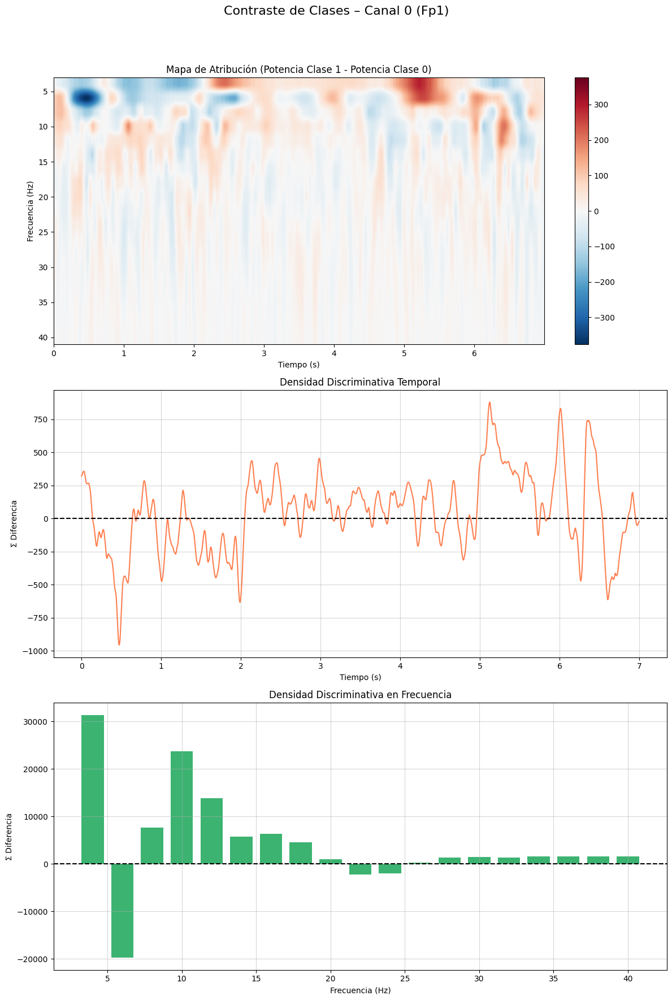


========= CANAL 1 (Fpz) / 63 =========


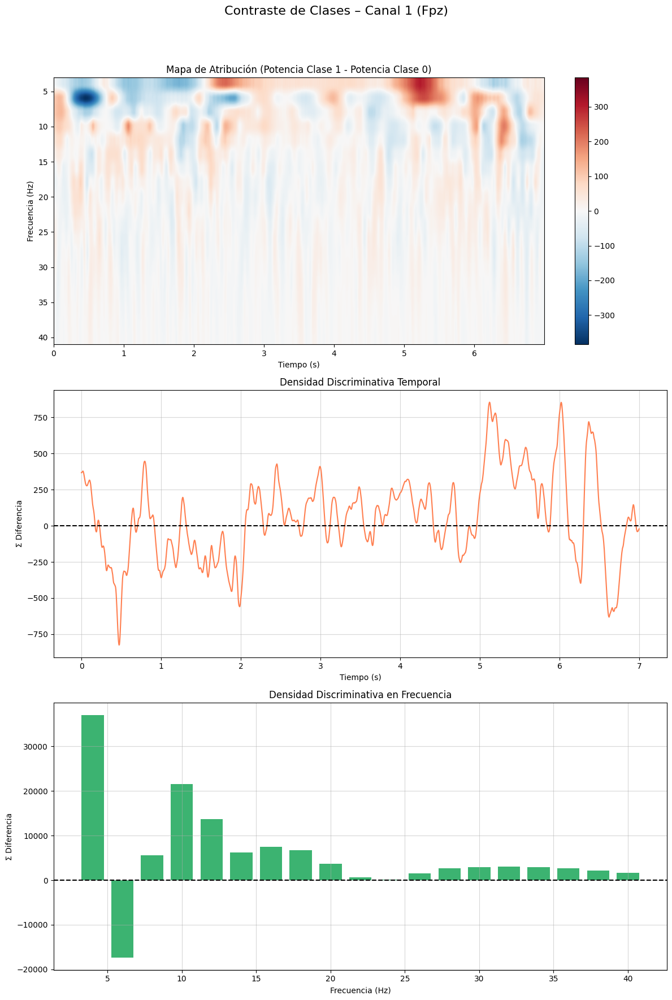


========= CANAL 2 (Fp2) / 63 =========


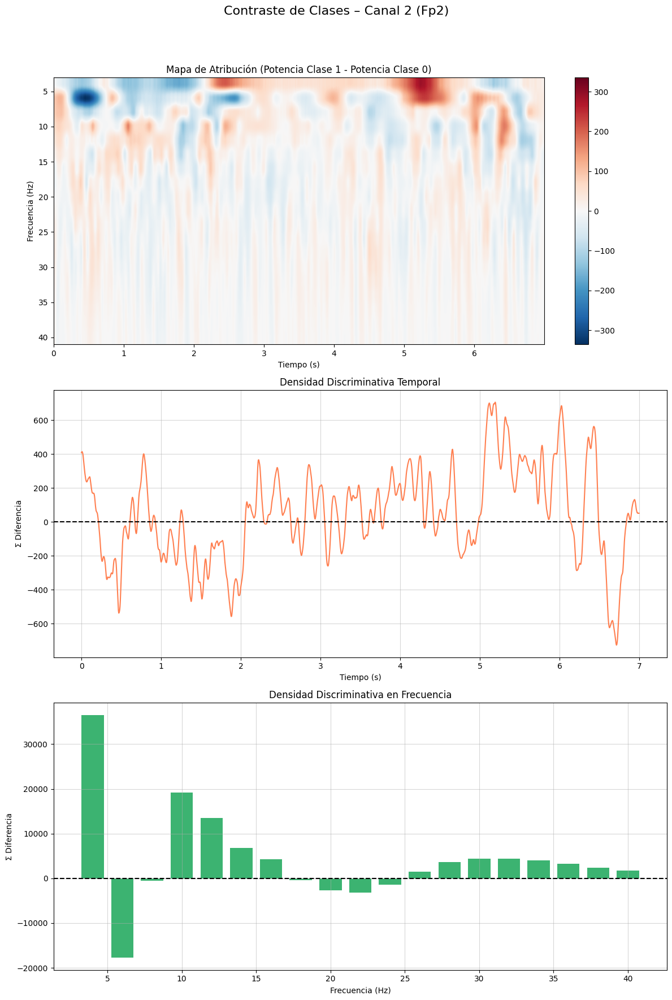


========= CANAL 3 (AF7) / 63 =========


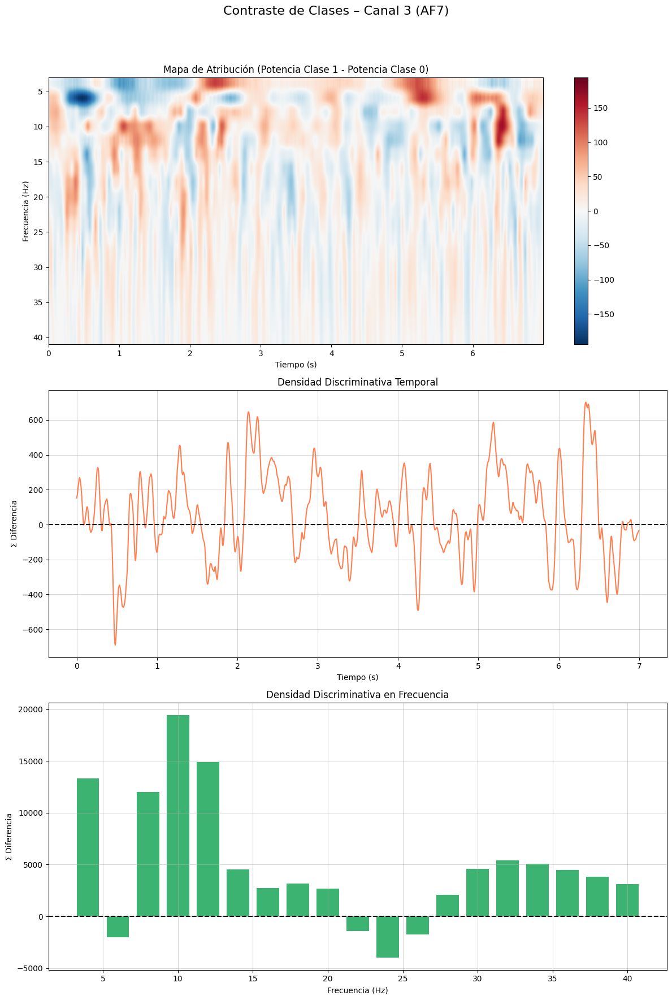


========= CANAL 4 (AF3) / 63 =========


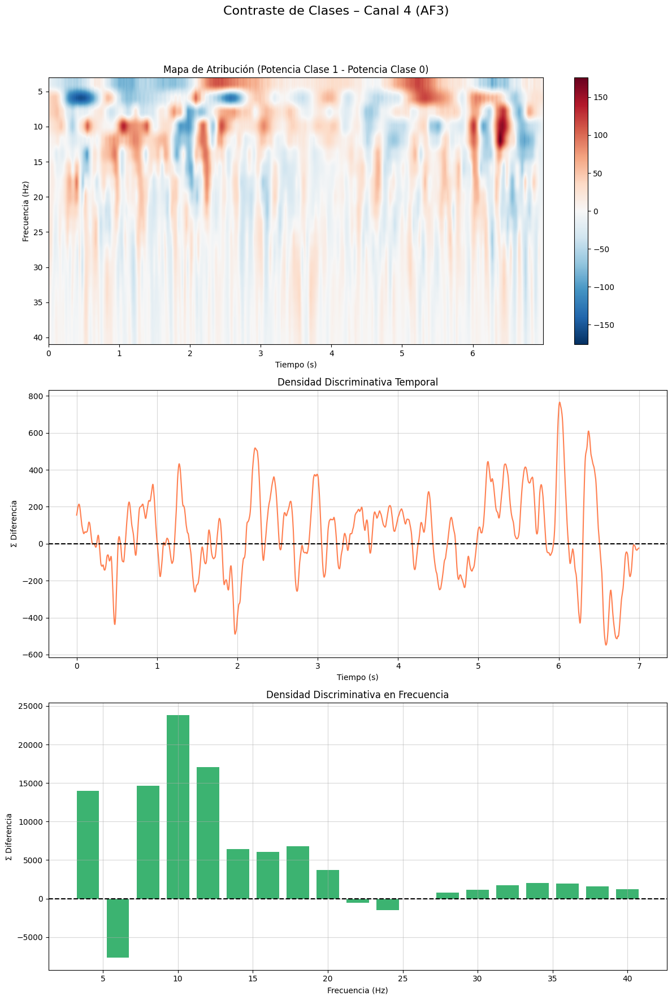


========= CANAL 5 (AFz) / 63 =========


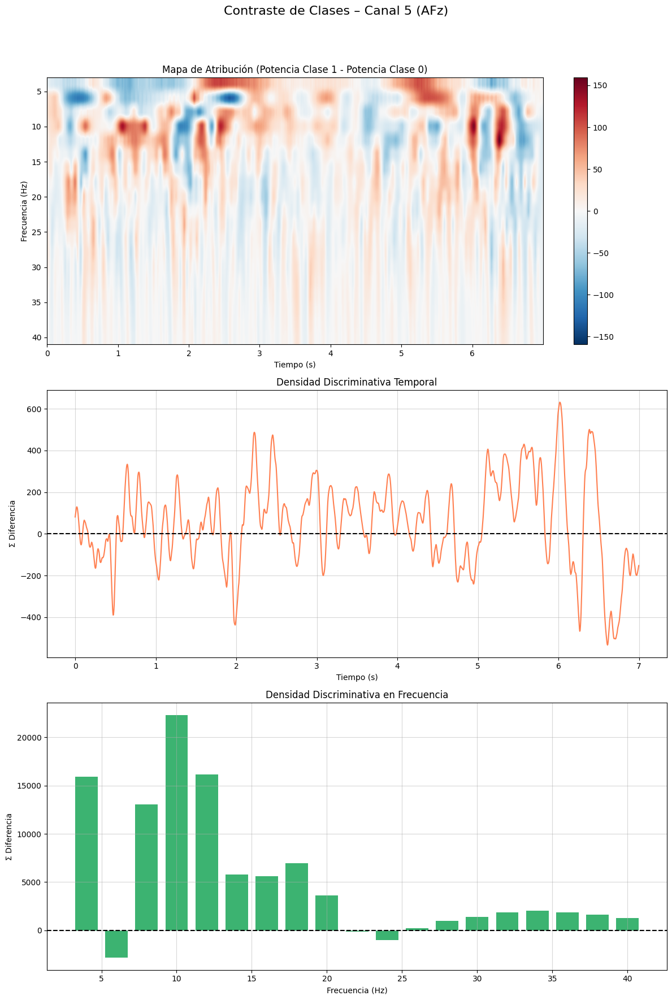


========= CANAL 6 (AF4) / 63 =========


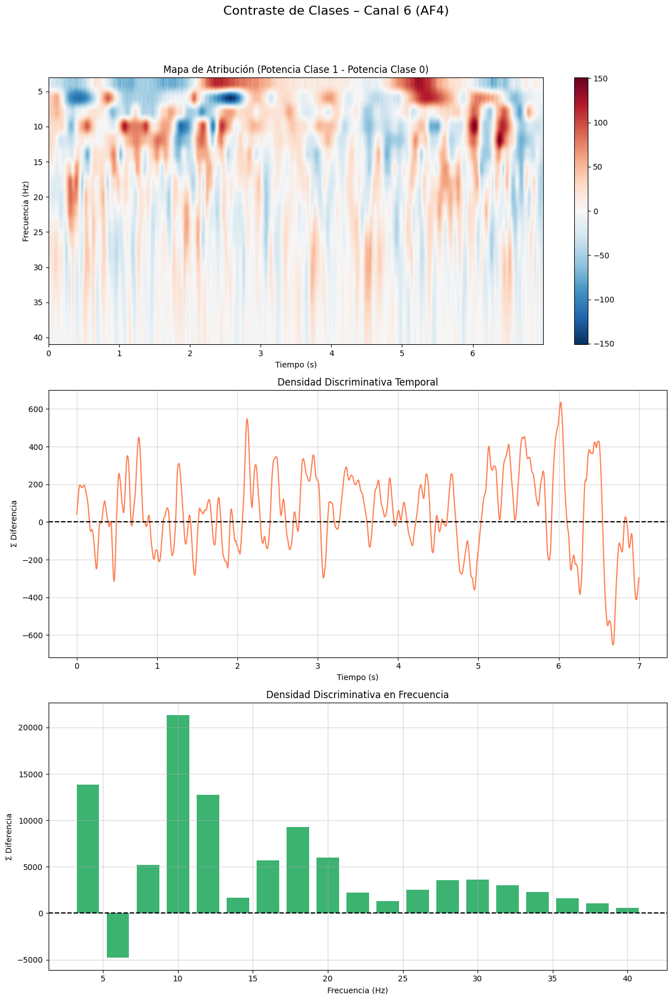


========= CANAL 7 (AF8) / 63 =========


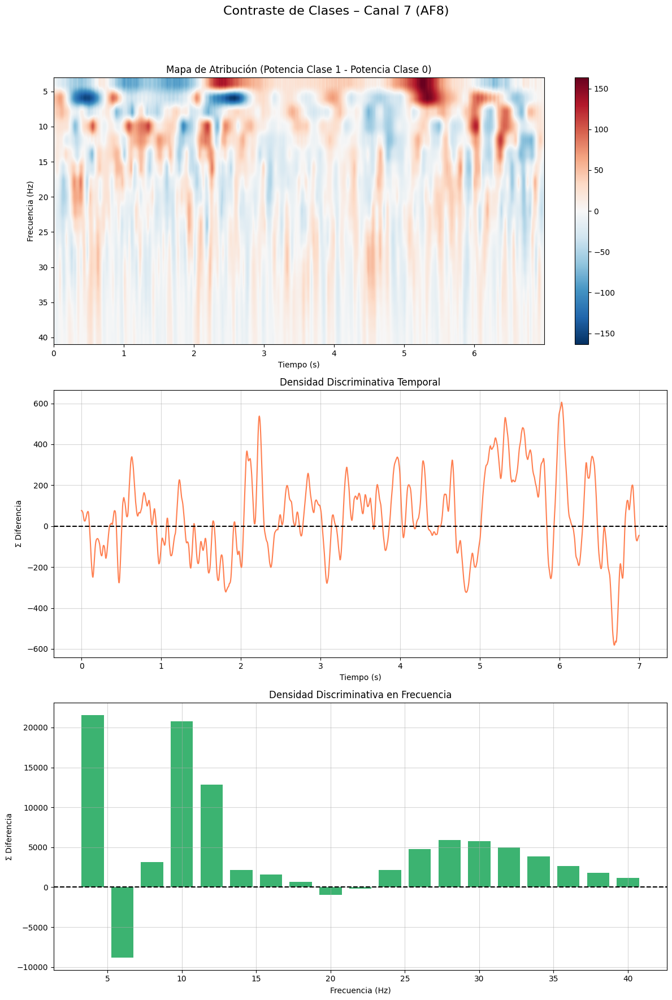


========= CANAL 8 (F7) / 63 =========


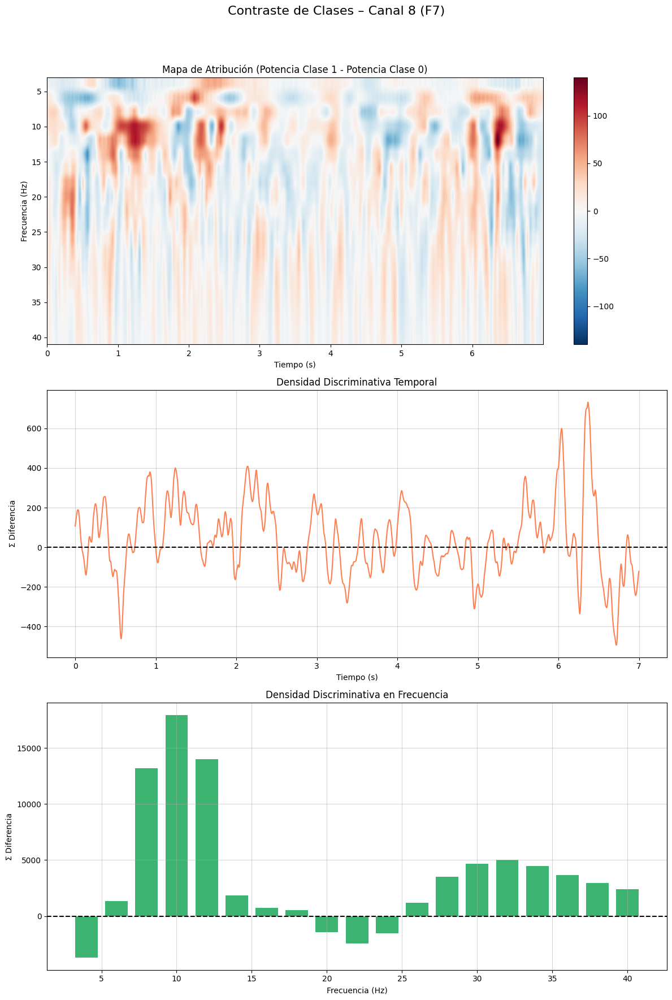


========= CANAL 9 (F5) / 63 =========


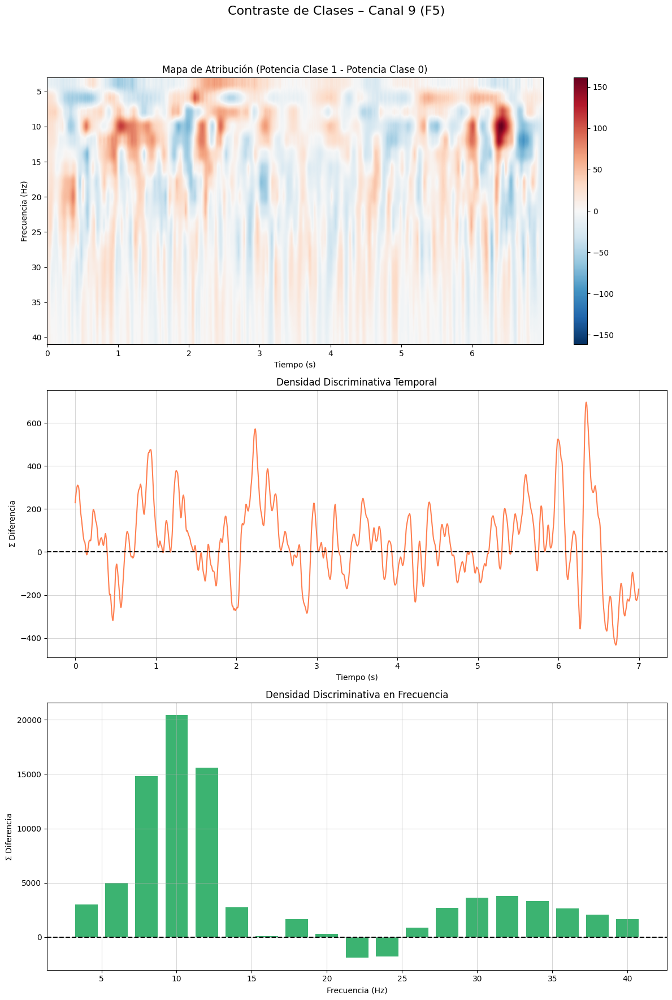


========= CANAL 10 (F3) / 63 =========


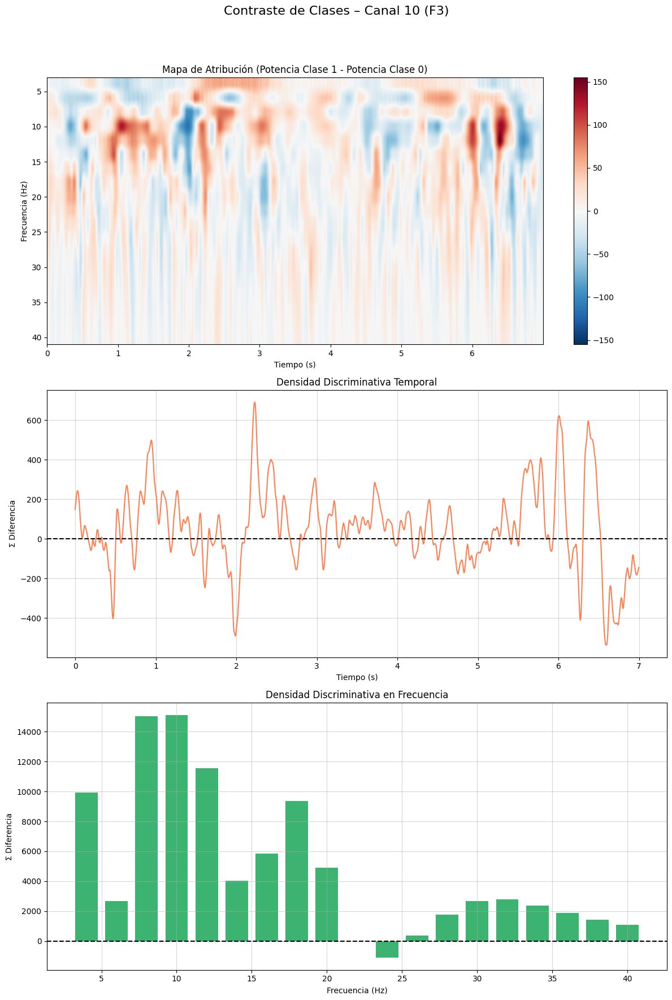


========= CANAL 11 (F1) / 63 =========


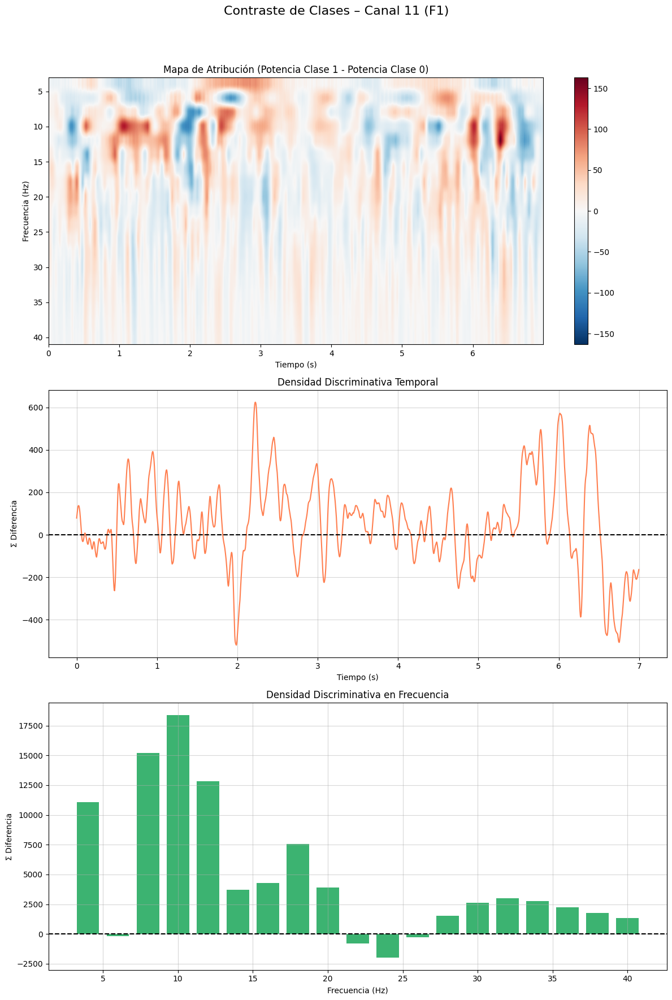


========= CANAL 12 (Fz) / 63 =========


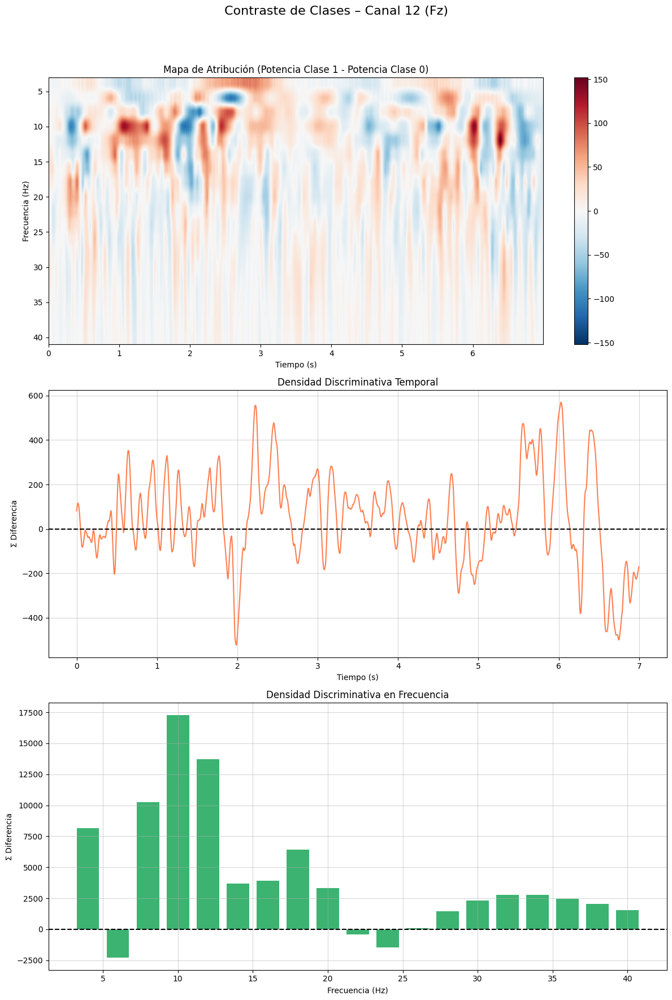


========= CANAL 13 (F2) / 63 =========


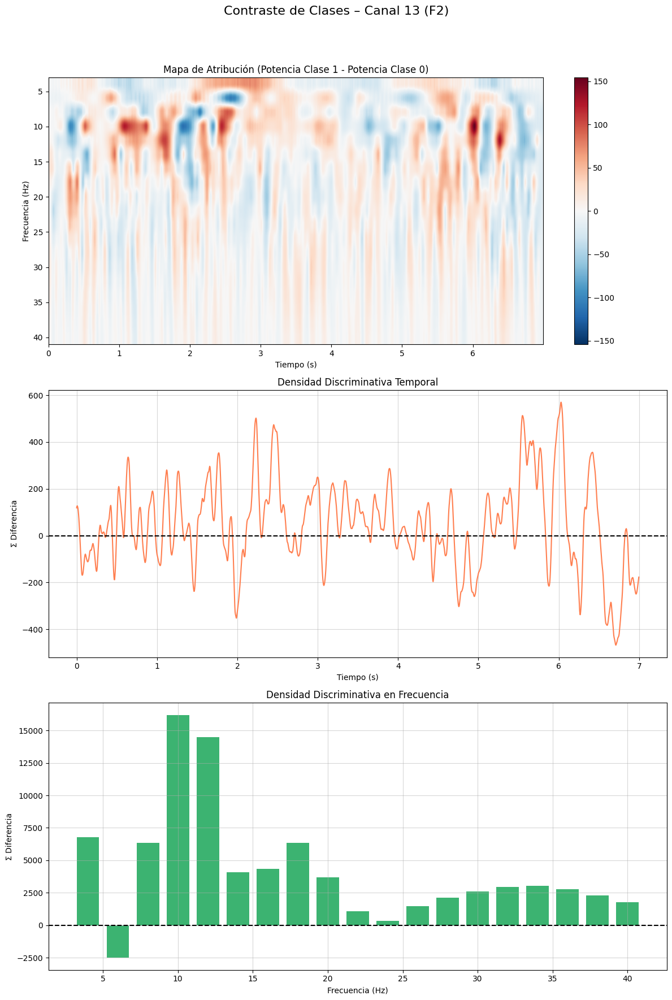


========= CANAL 14 (F4) / 63 =========


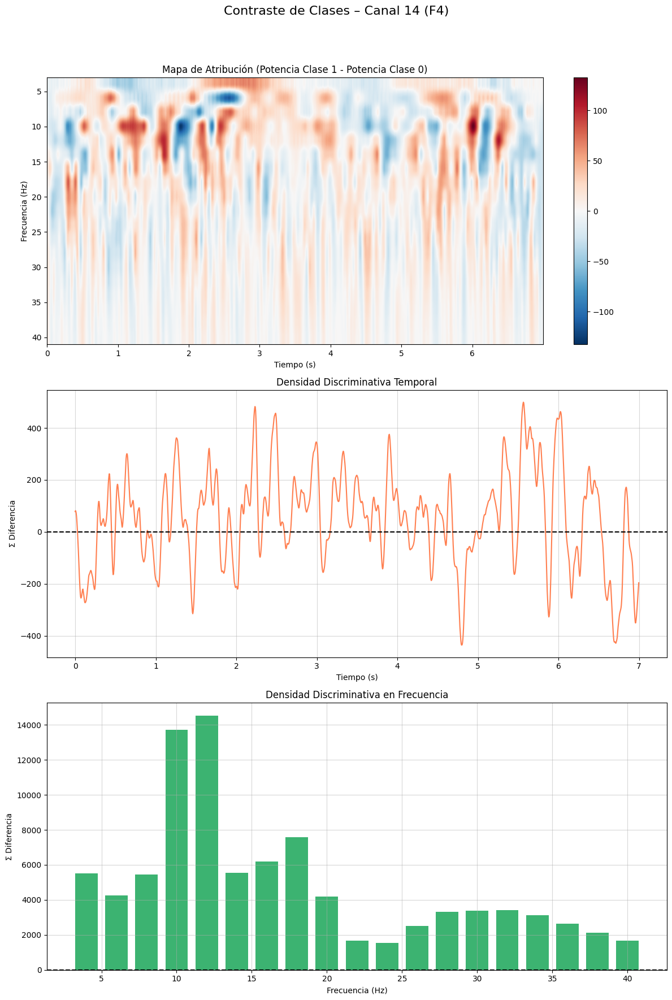


========= CANAL 15 (F6) / 63 =========


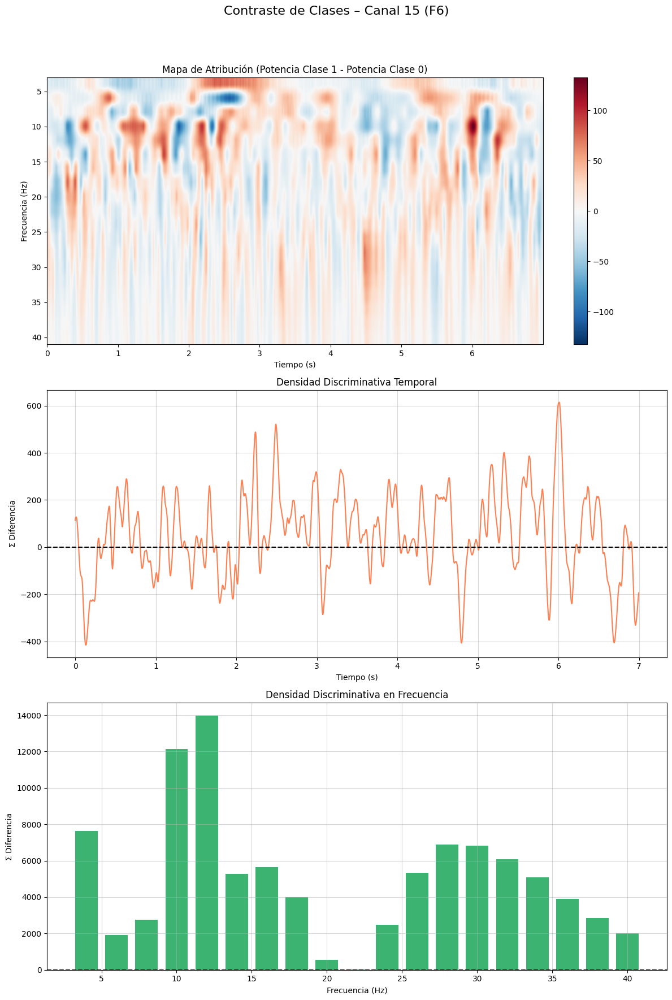


========= CANAL 16 (F8) / 63 =========


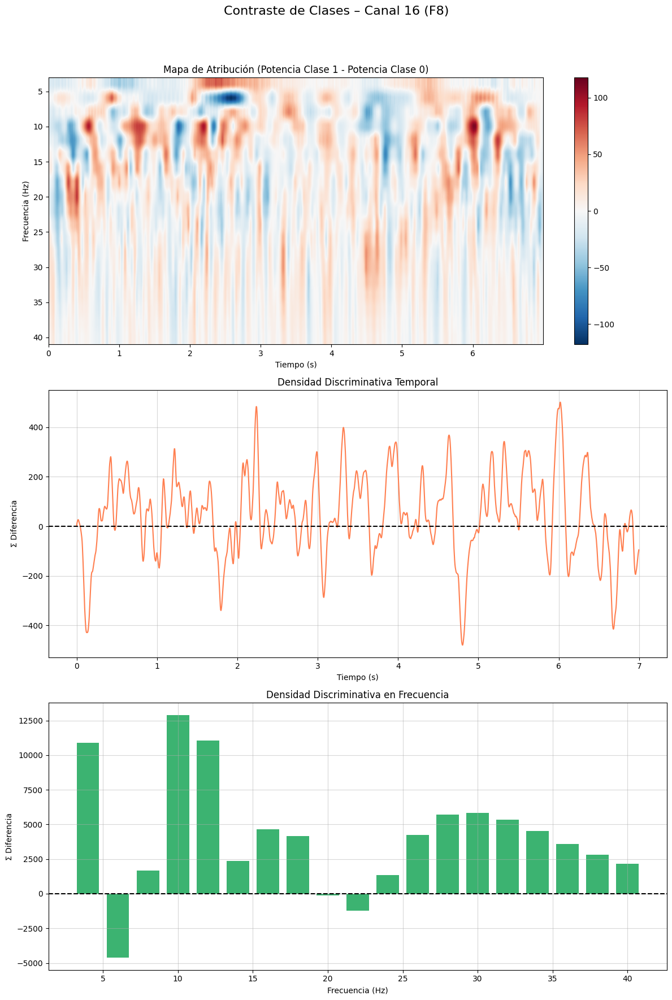


========= CANAL 17 (FT7) / 63 =========


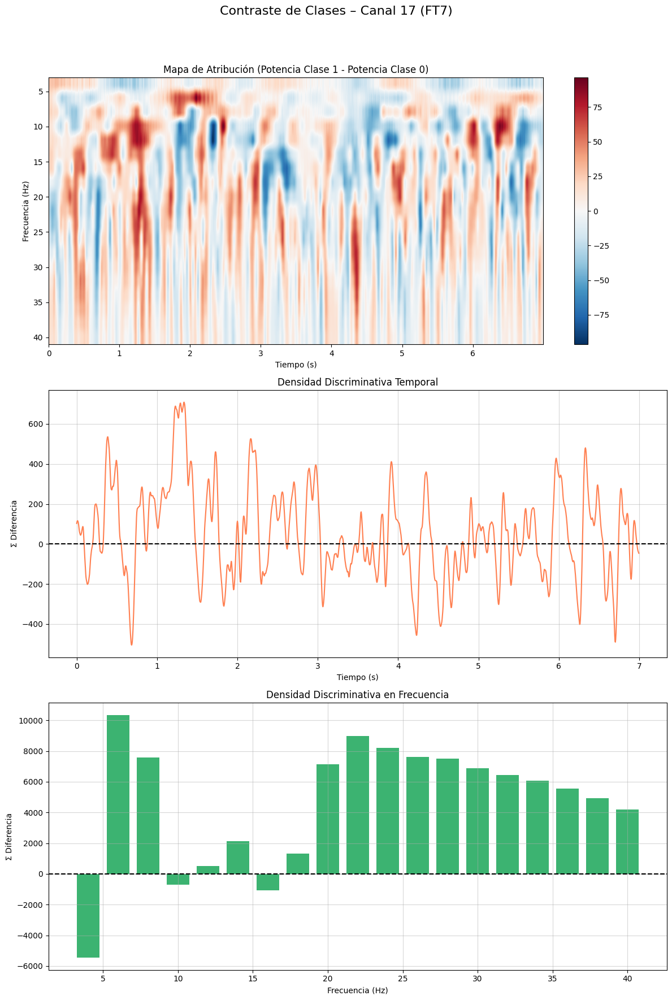


========= CANAL 18 (FC5) / 63 =========


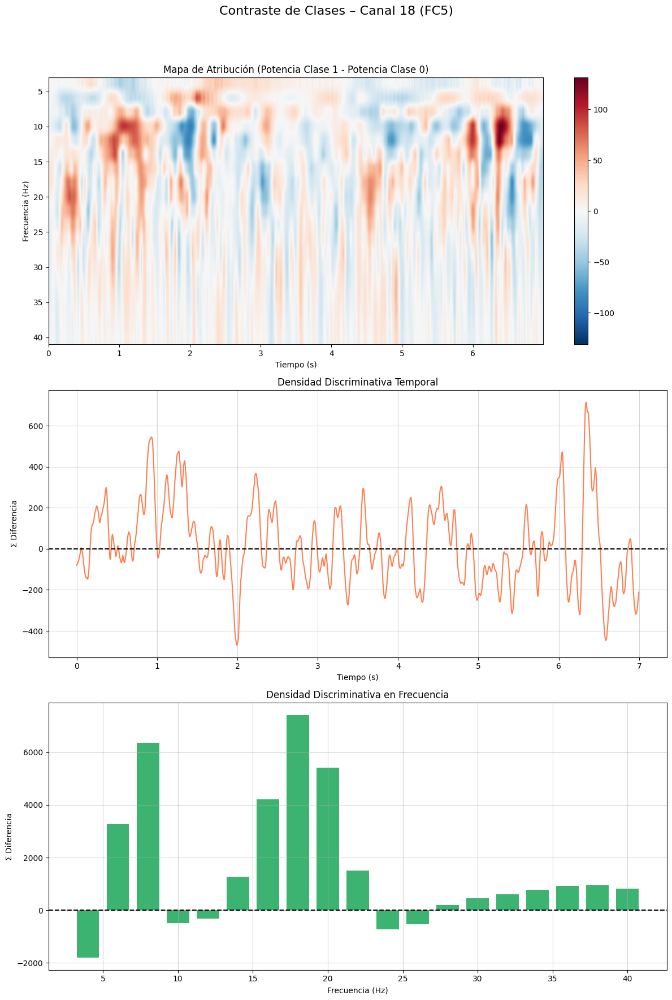


========= CANAL 19 (FC3) / 63 =========


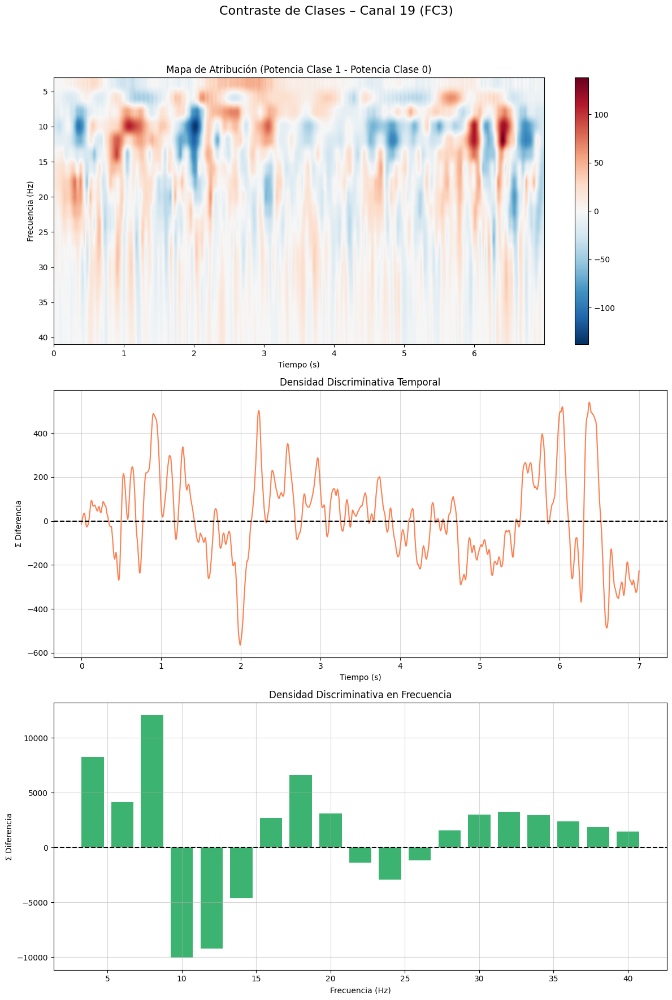


========= CANAL 20 (FC1) / 63 =========


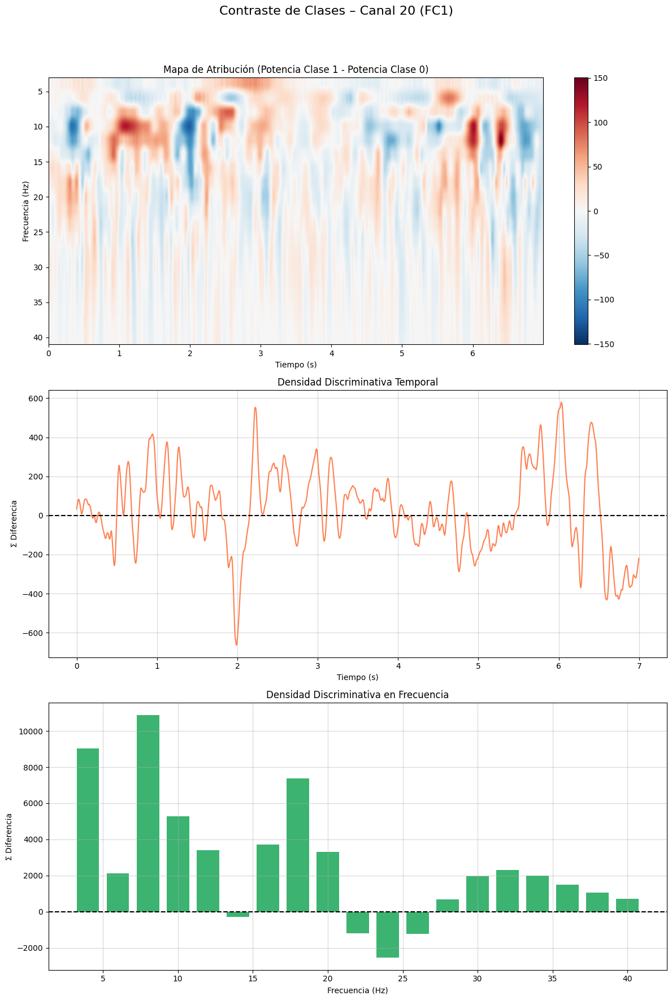


========= CANAL 21 (FCz) / 63 =========


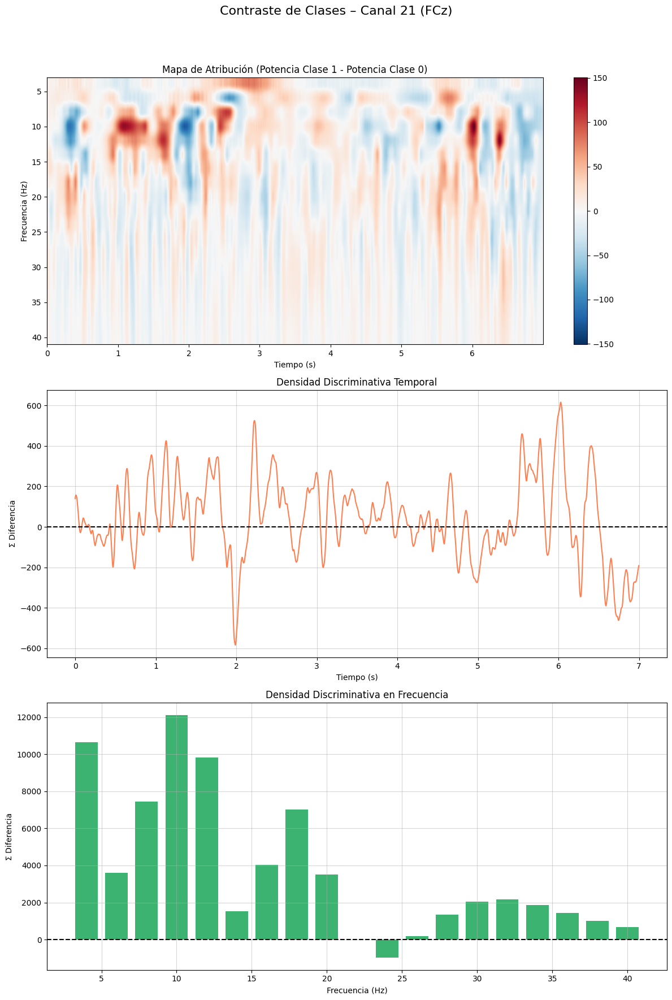


========= CANAL 22 (FC2) / 63 =========


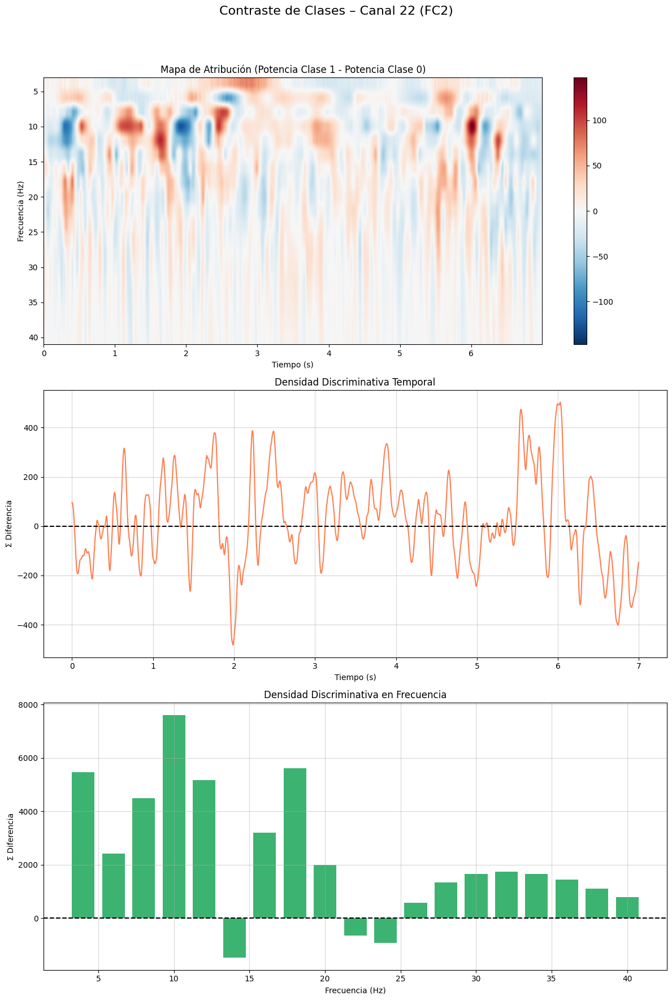


========= CANAL 23 (FC4) / 63 =========


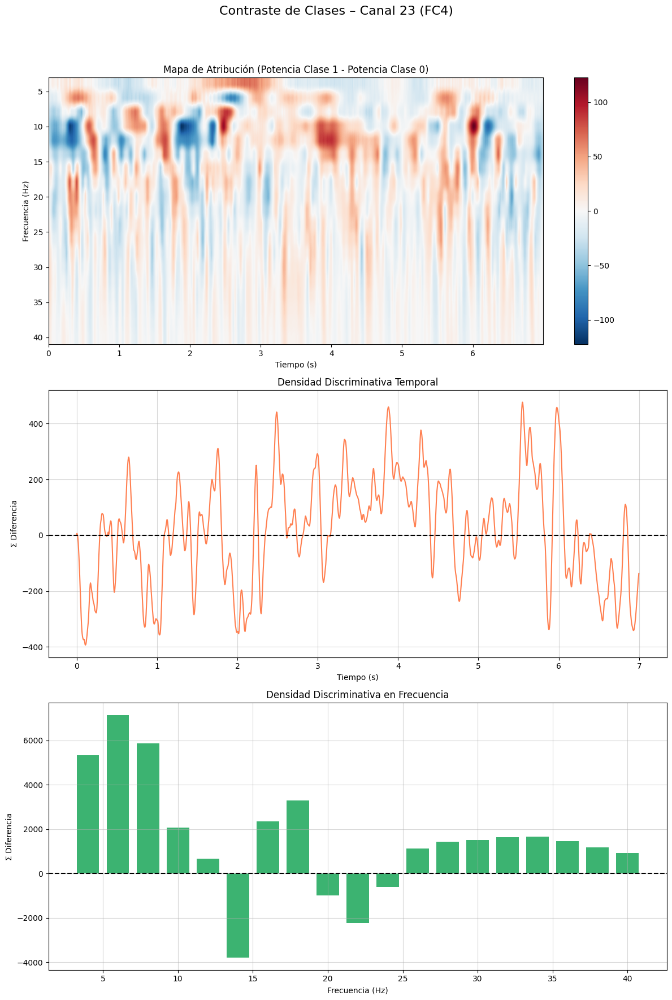


========= CANAL 24 (FC6) / 63 =========


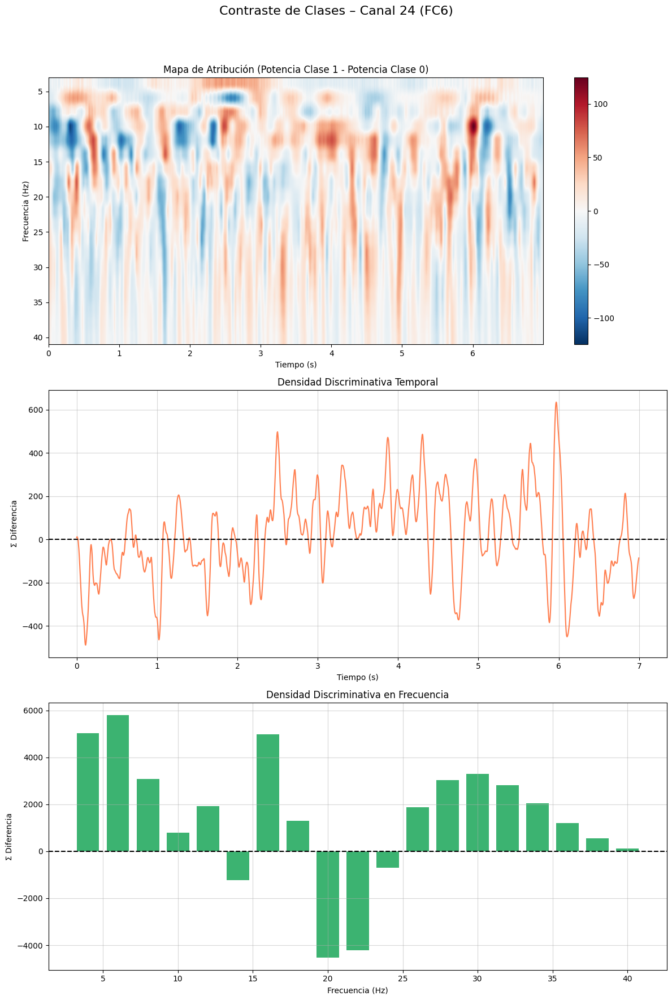


========= CANAL 25 (FT8) / 63 =========


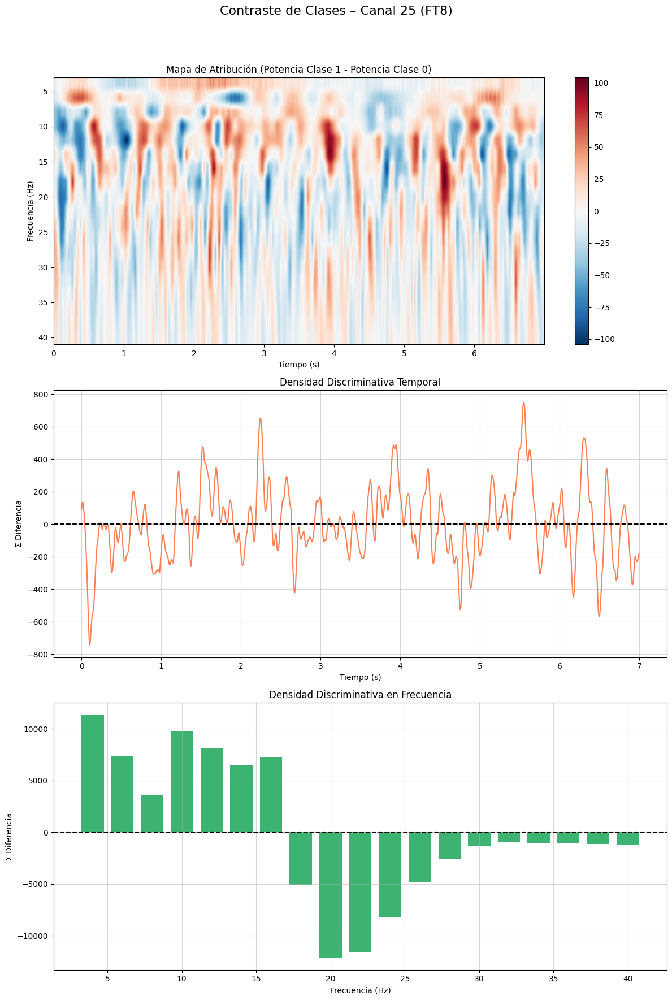


========= CANAL 26 (T7) / 63 =========


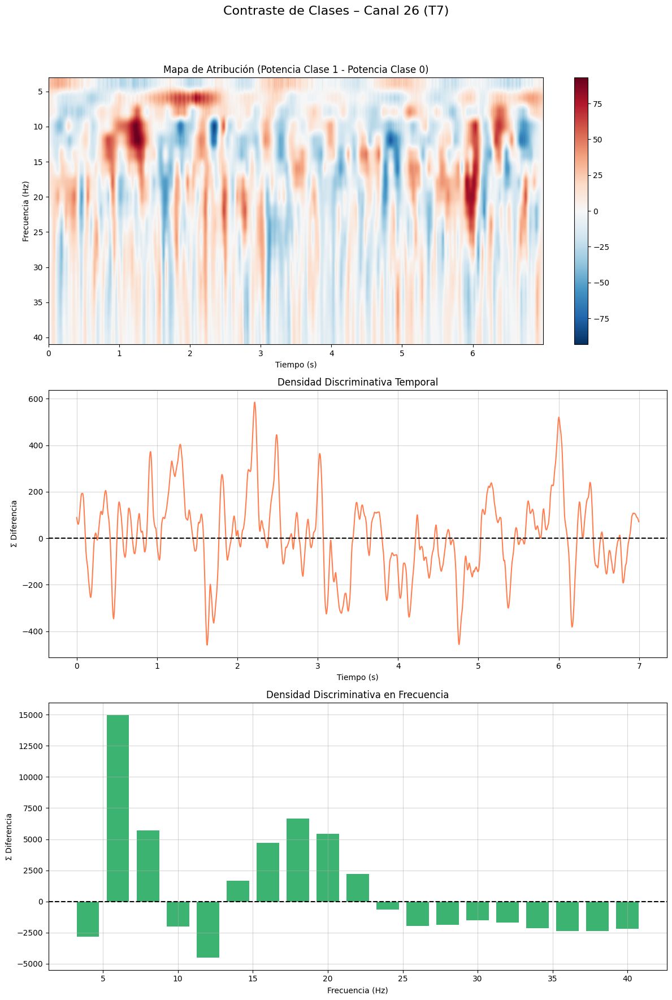


========= CANAL 27 (C5) / 63 =========


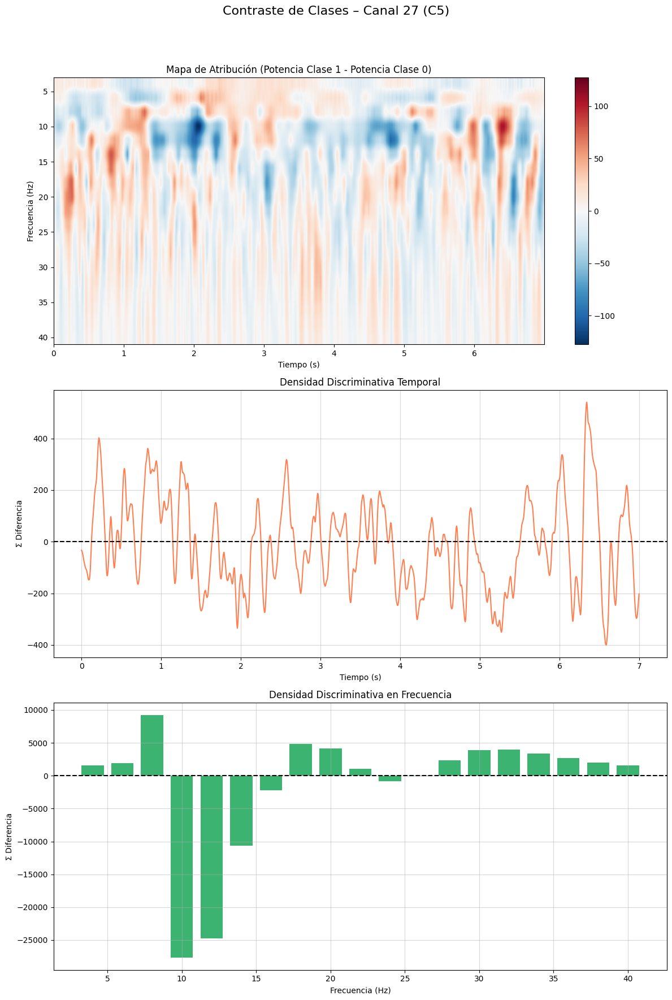


========= CANAL 28 (C3) / 63 =========


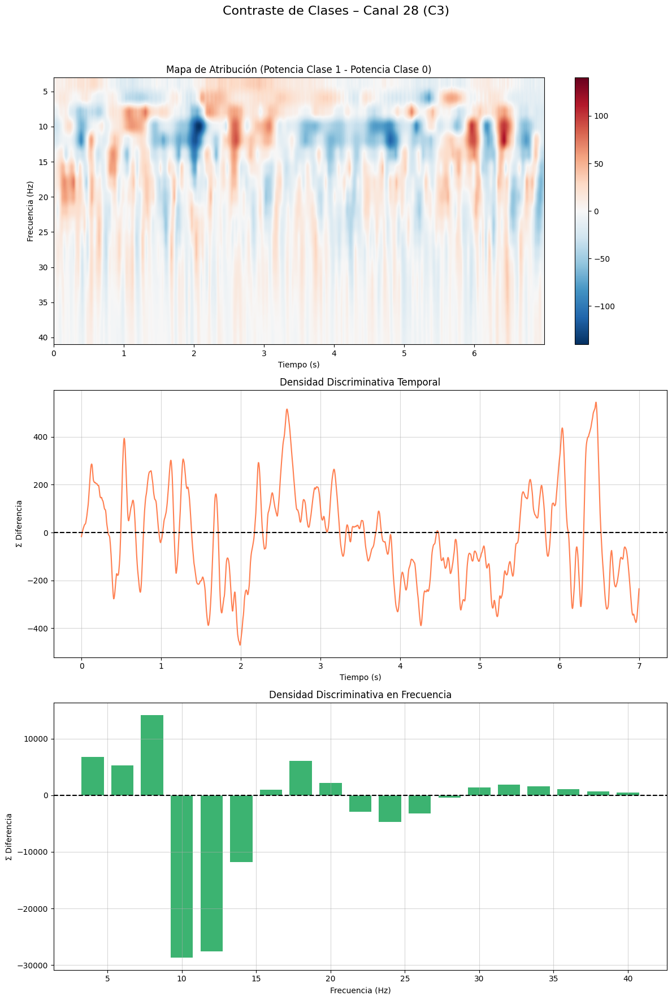


========= CANAL 29 (C1) / 63 =========


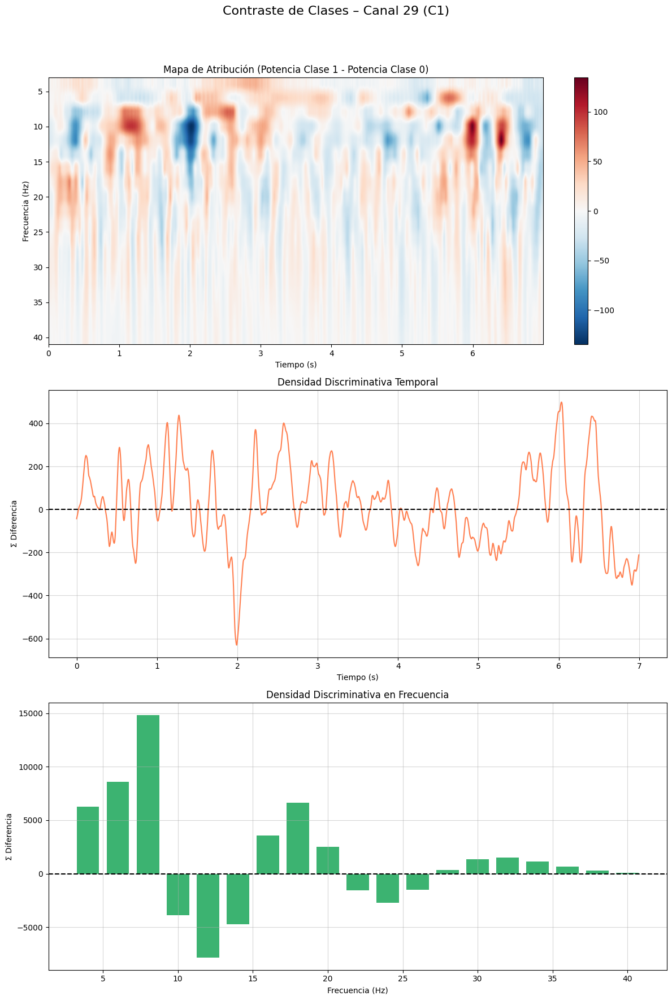


========= CANAL 30 (Cz) / 63 =========


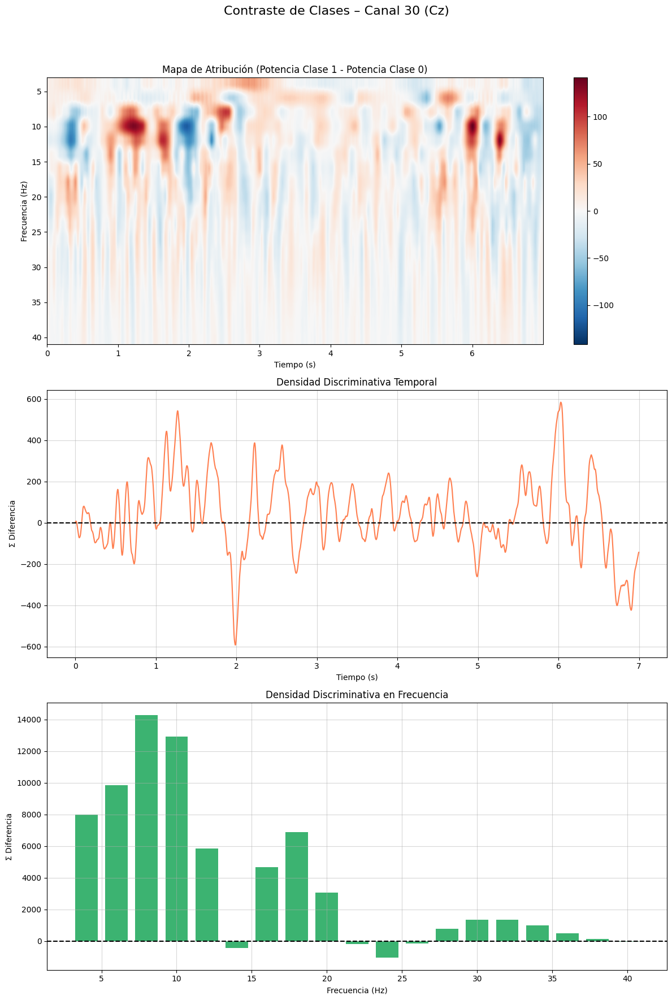


========= CANAL 31 (C2) / 63 =========


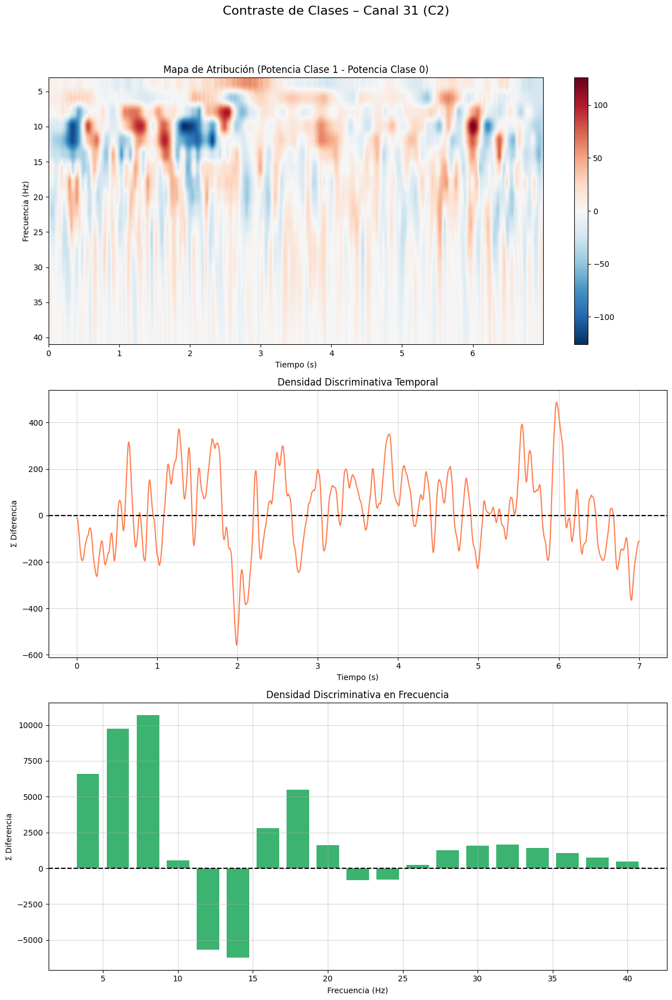


========= CANAL 32 (C4) / 63 =========


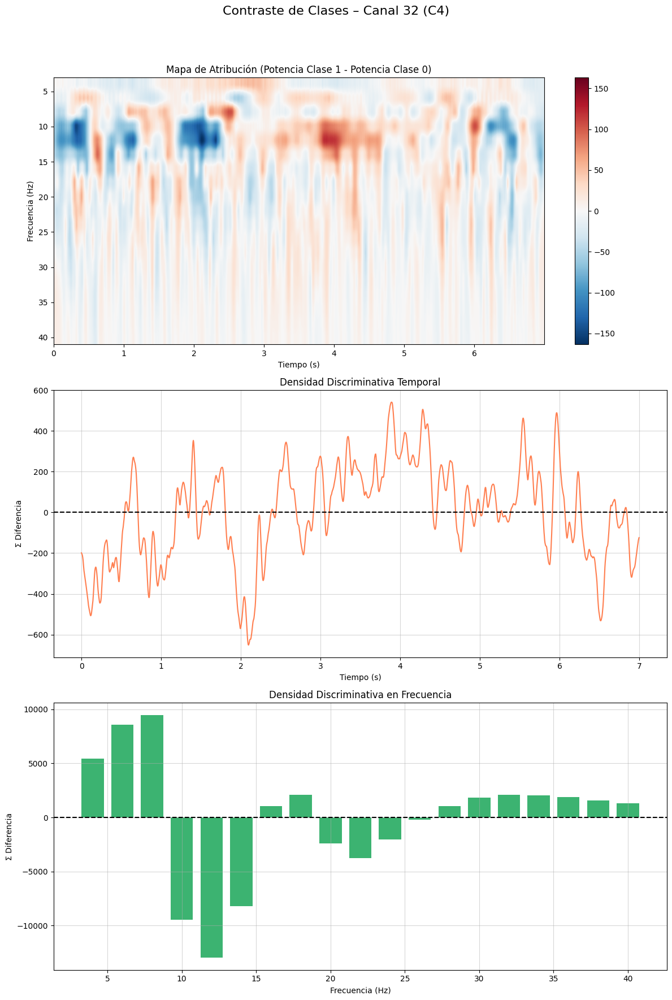


========= CANAL 33 (C6) / 63 =========


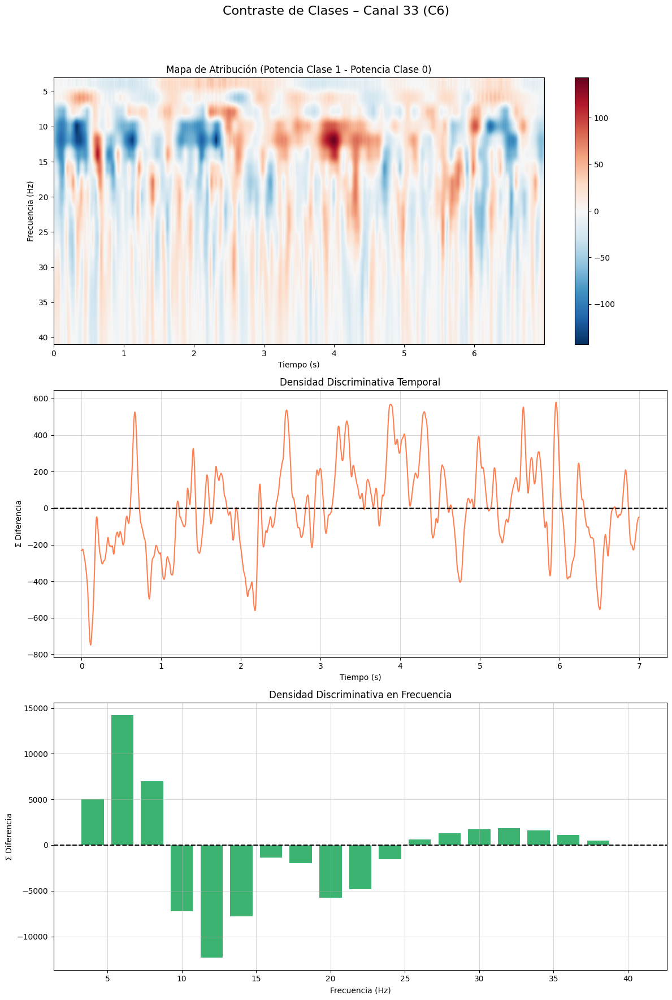


========= CANAL 34 (T8) / 63 =========


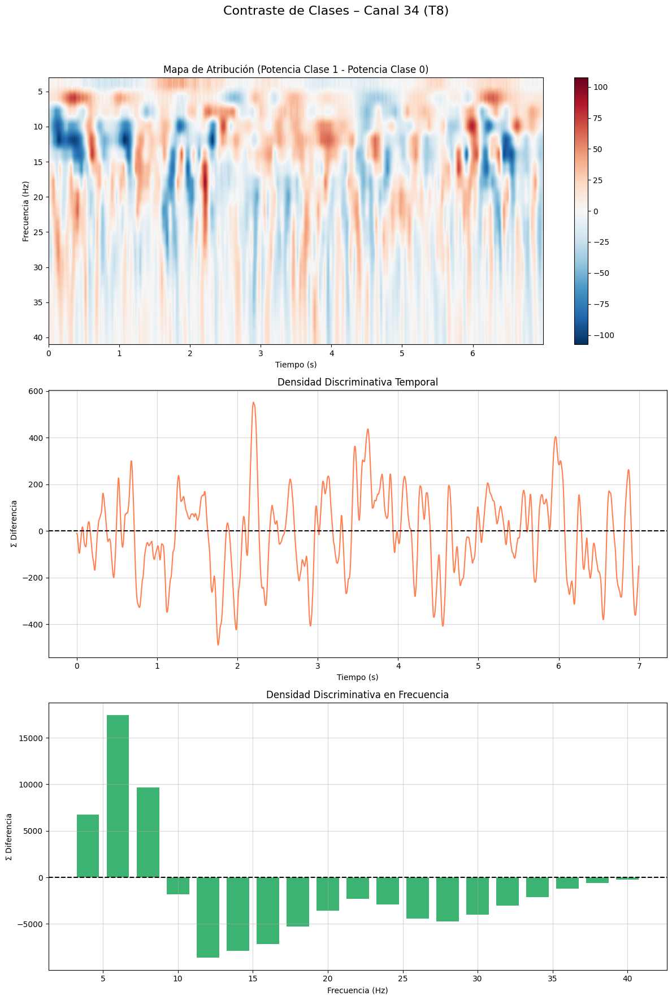


========= CANAL 35 (TP7) / 63 =========


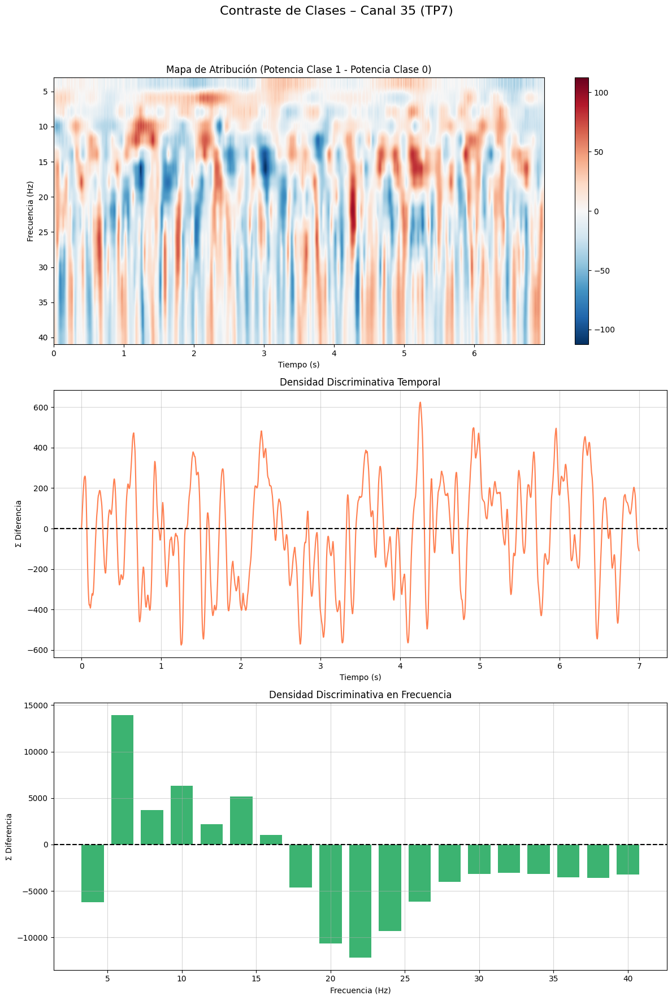


========= CANAL 36 (CP5) / 63 =========


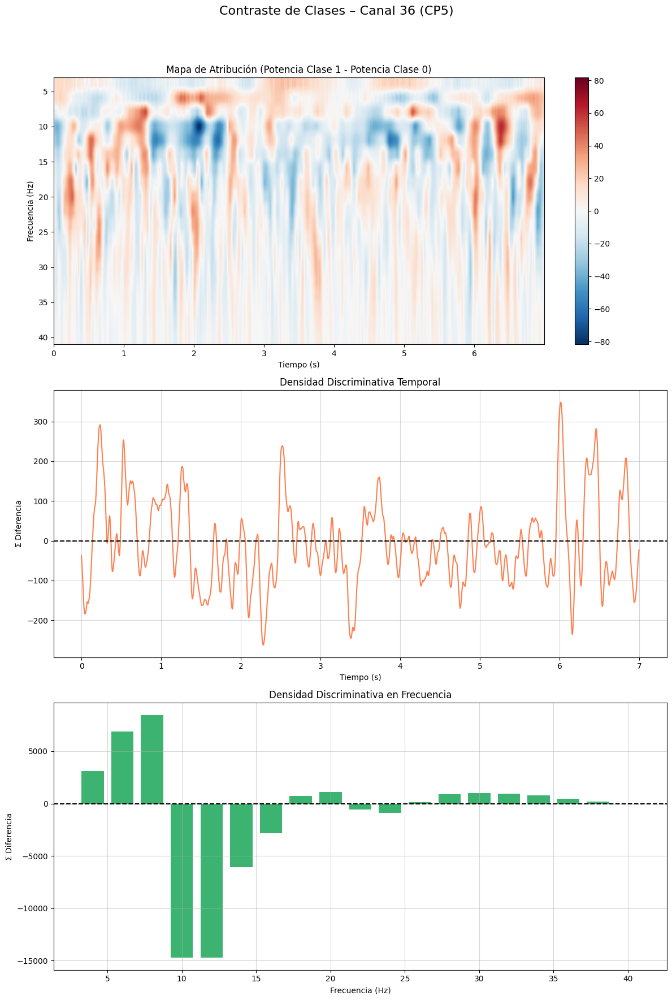


========= CANAL 37 (CP3) / 63 =========


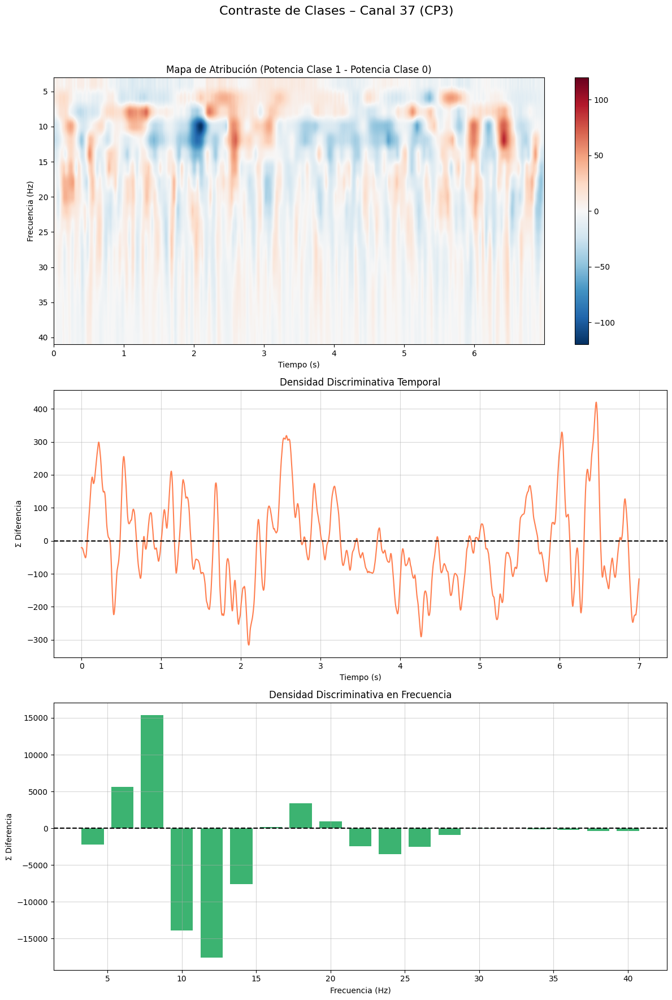


========= CANAL 38 (CP1) / 63 =========


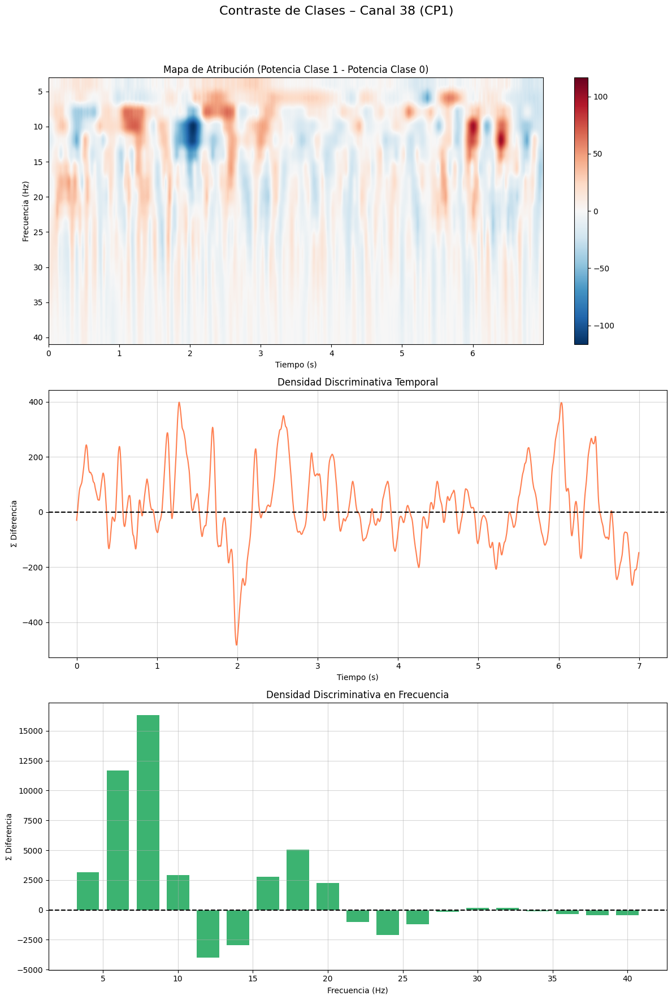


========= CANAL 39 (CPz) / 63 =========


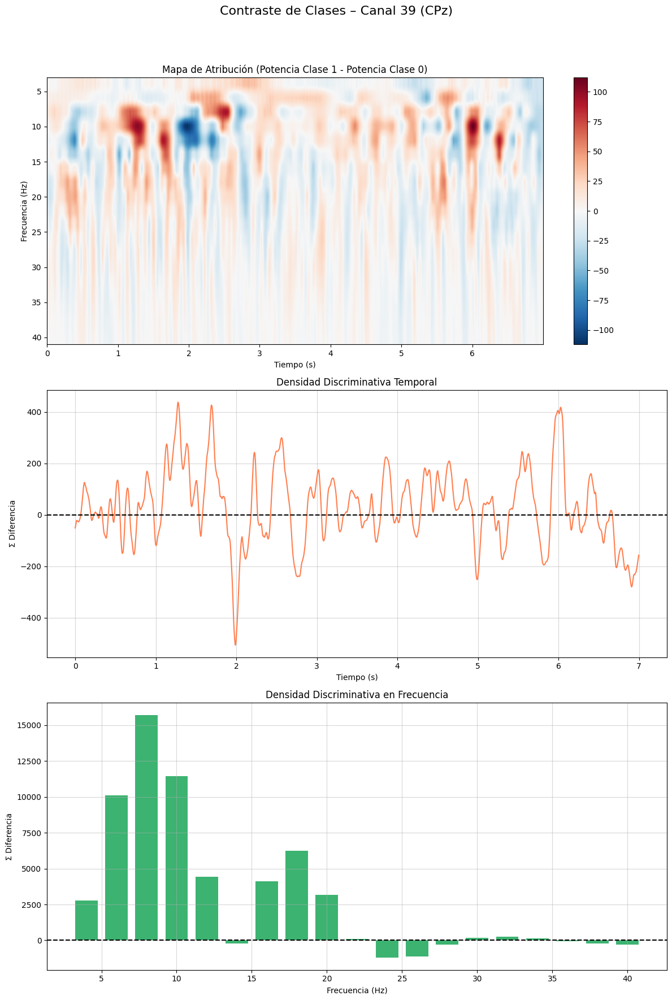


========= CANAL 40 (CP2) / 63 =========


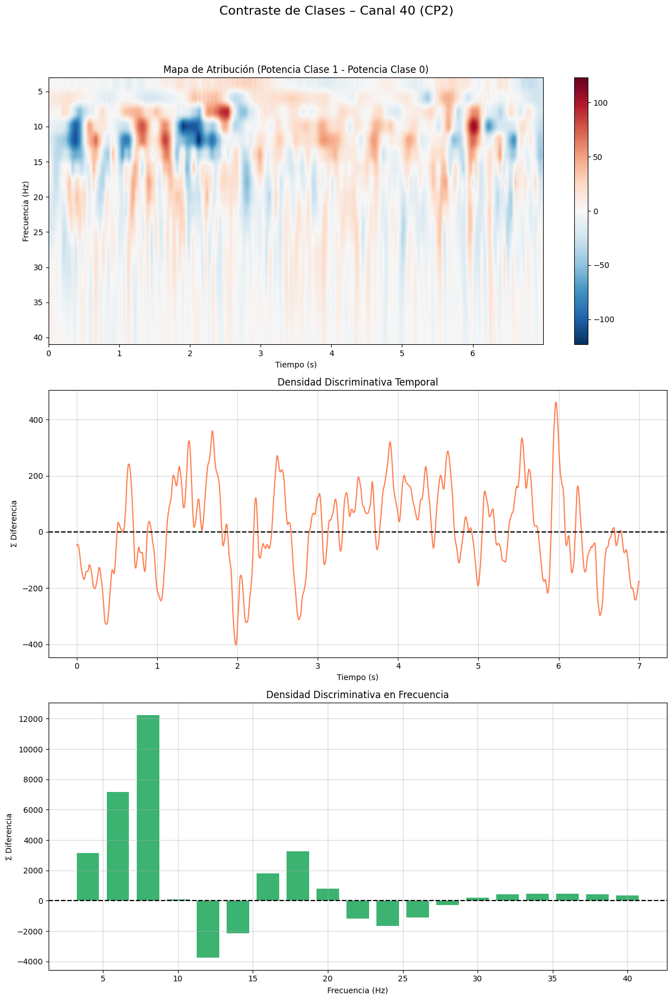


========= CANAL 41 (CP4) / 63 =========


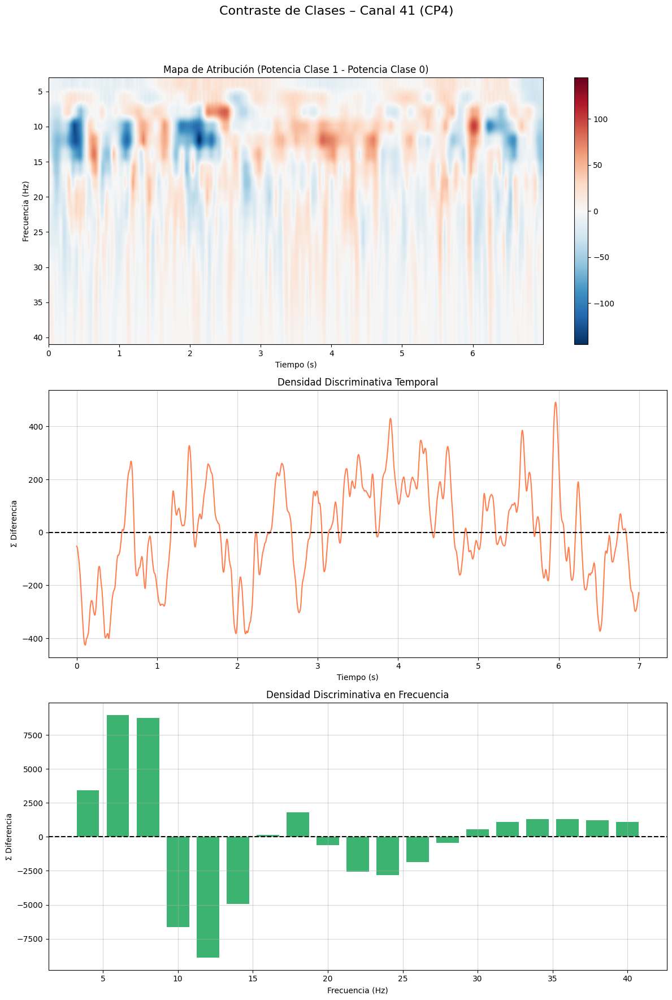


========= CANAL 42 (CP6) / 63 =========


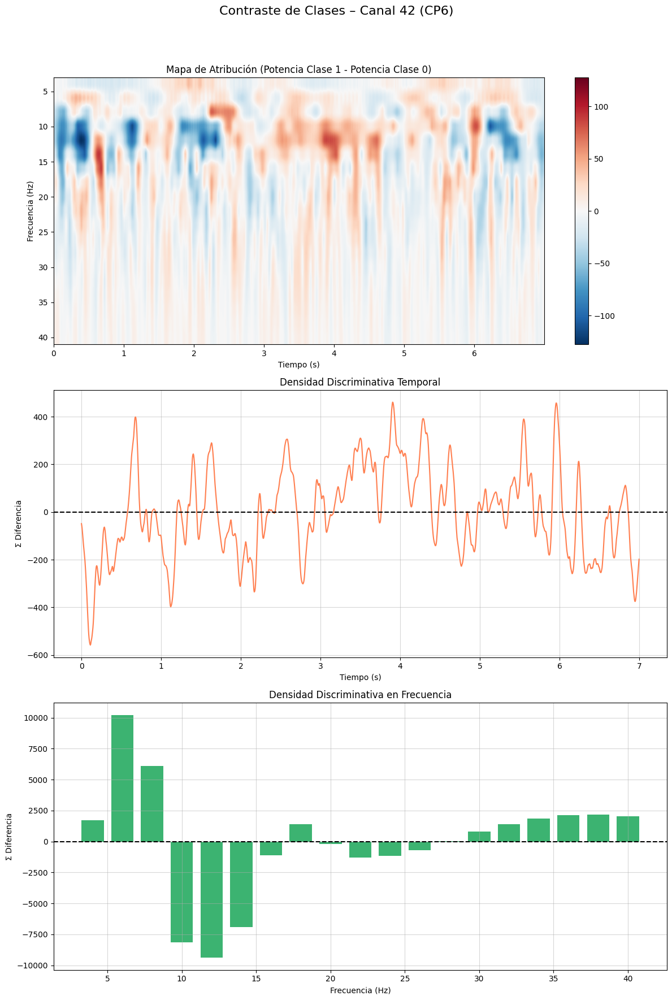


========= CANAL 43 (TP8) / 63 =========


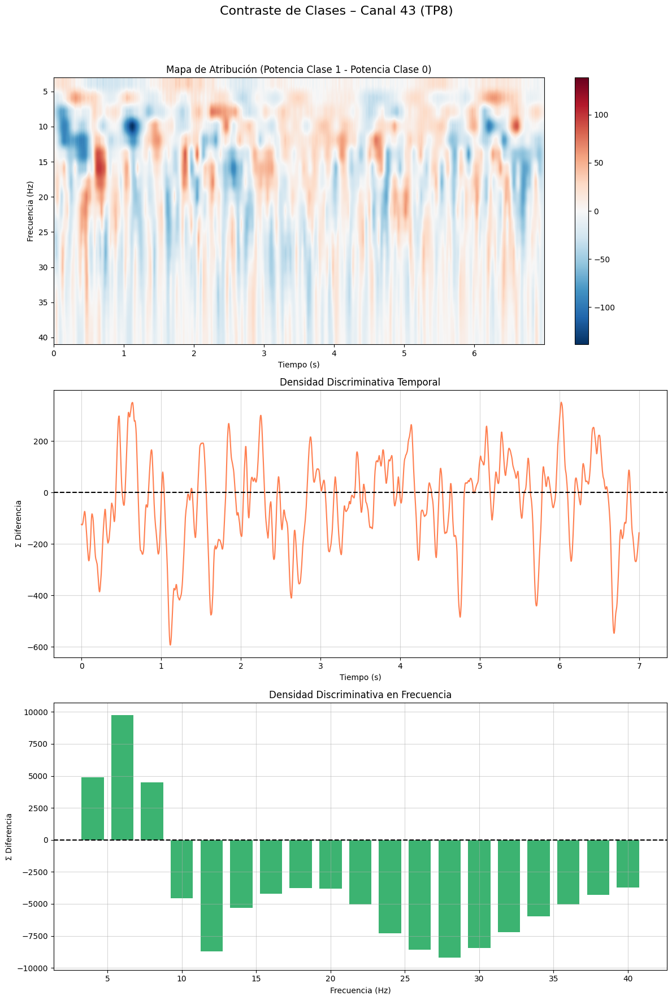


========= CANAL 44 (P9) / 63 =========


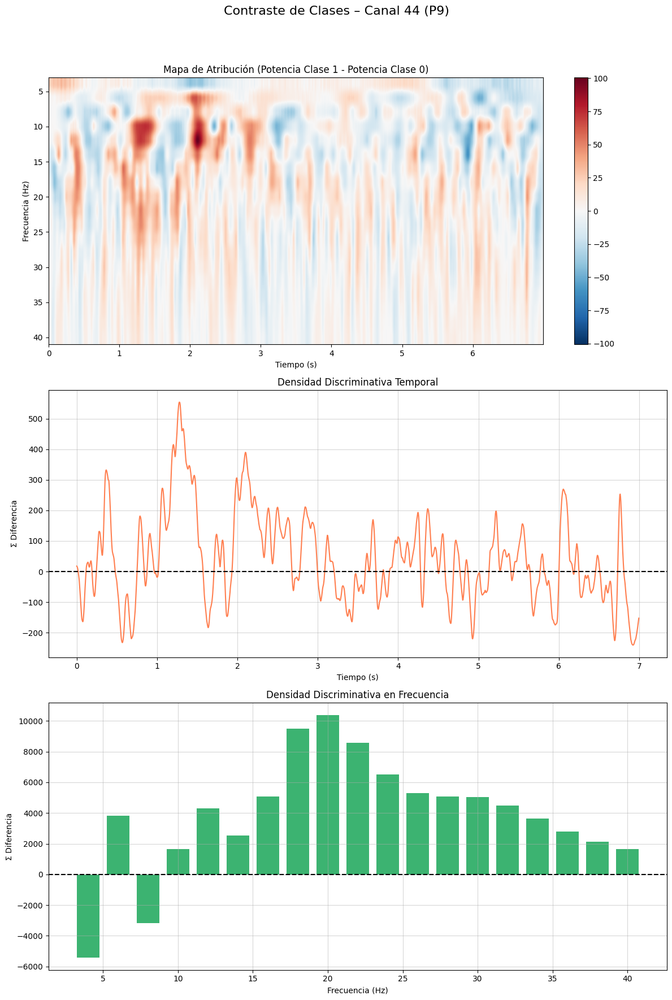


========= CANAL 45 (P7) / 63 =========


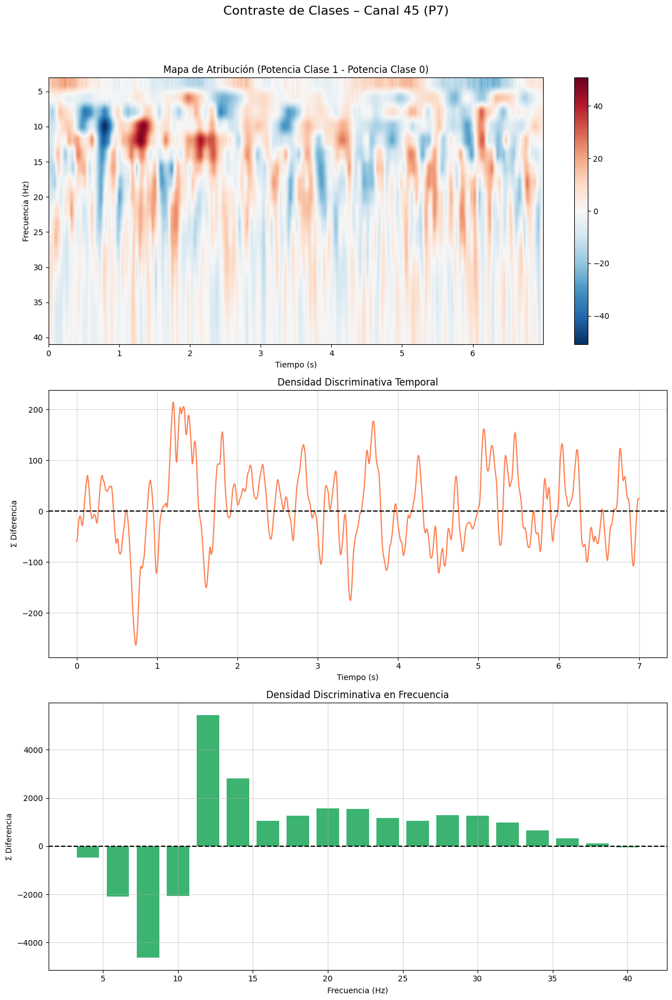


========= CANAL 46 (P5) / 63 =========


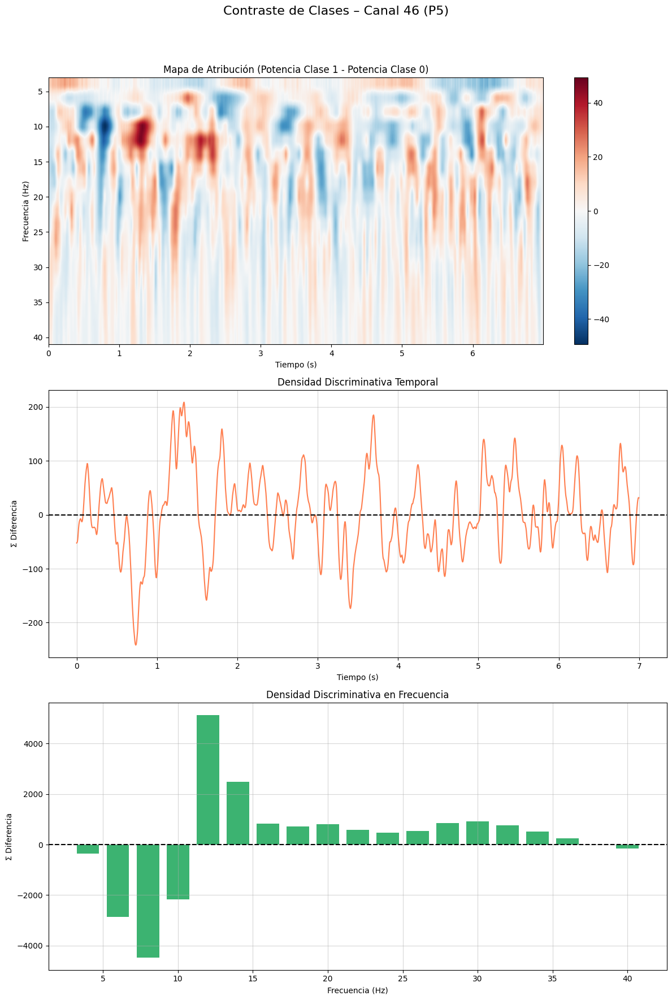


========= CANAL 47 (P3) / 63 =========


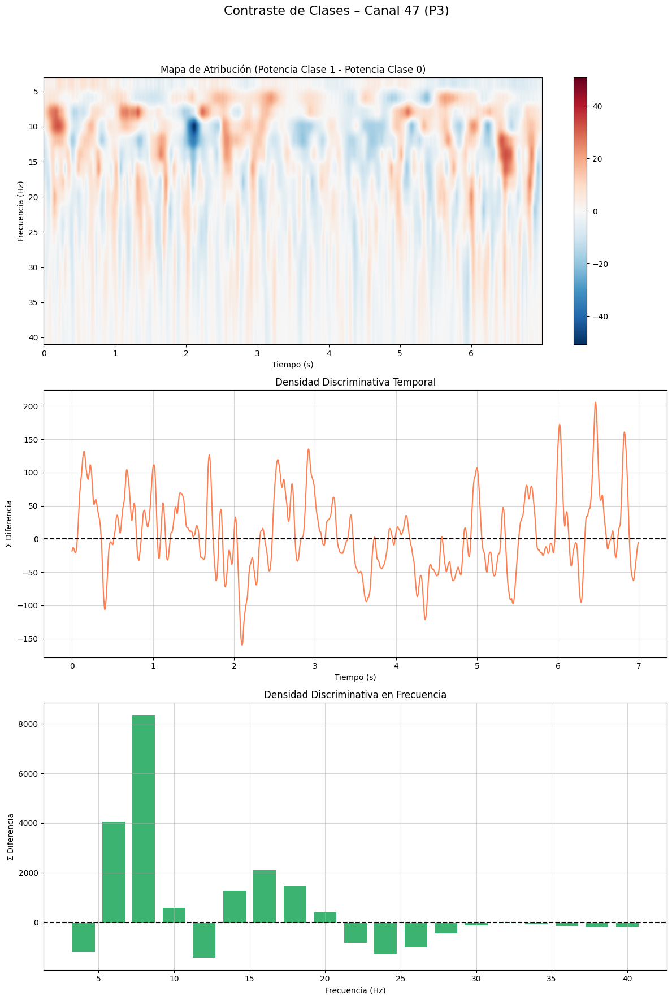


========= CANAL 48 (P1) / 63 =========


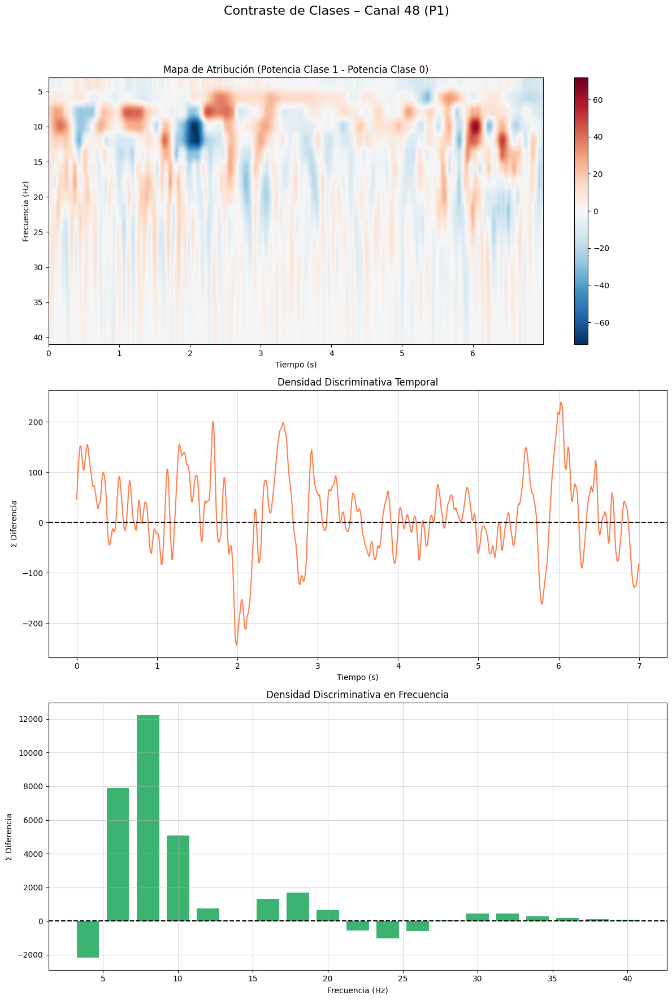


========= CANAL 49 (Pz) / 63 =========


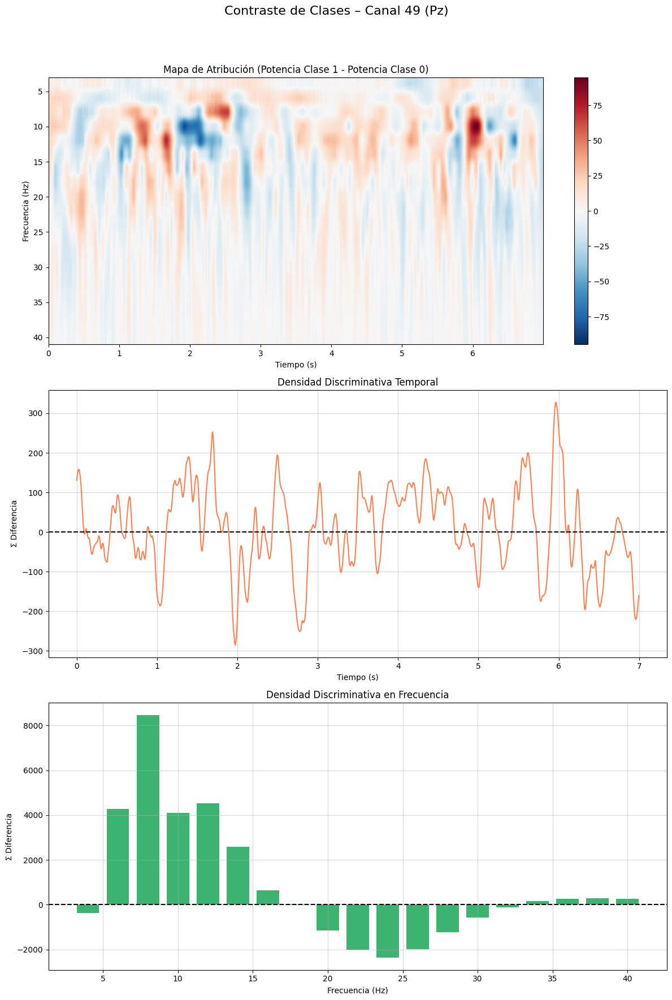


========= CANAL 50 (P2) / 63 =========


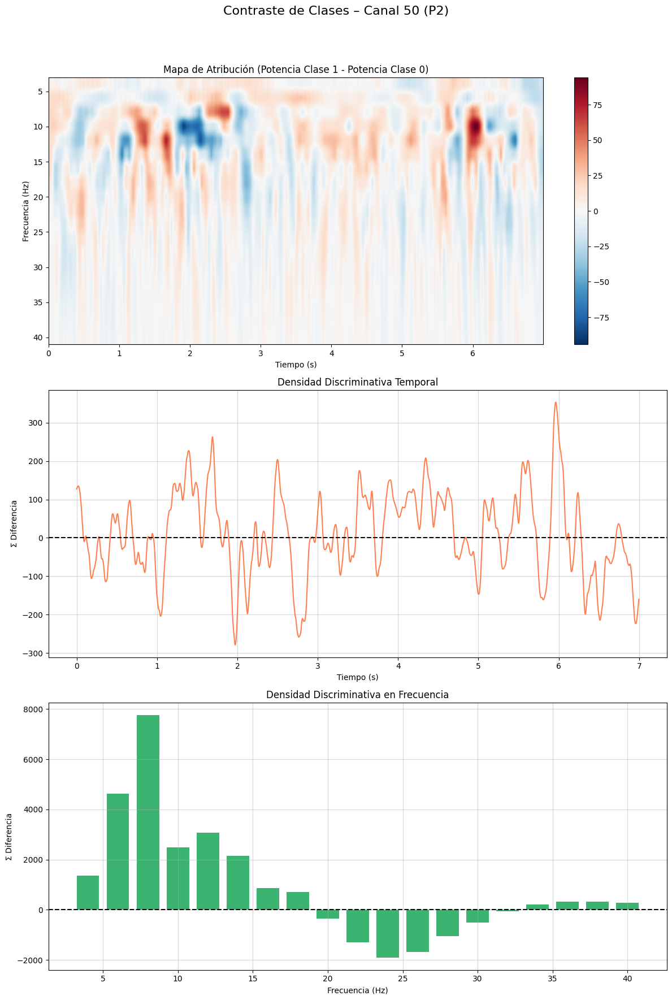


========= CANAL 51 (P4) / 63 =========


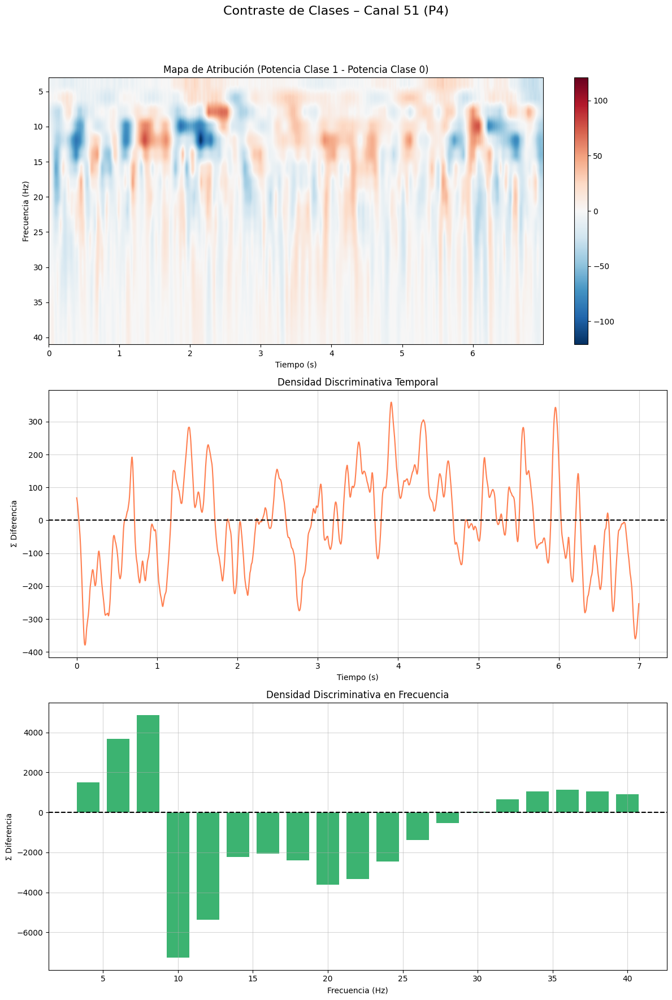


========= CANAL 52 (P6) / 63 =========


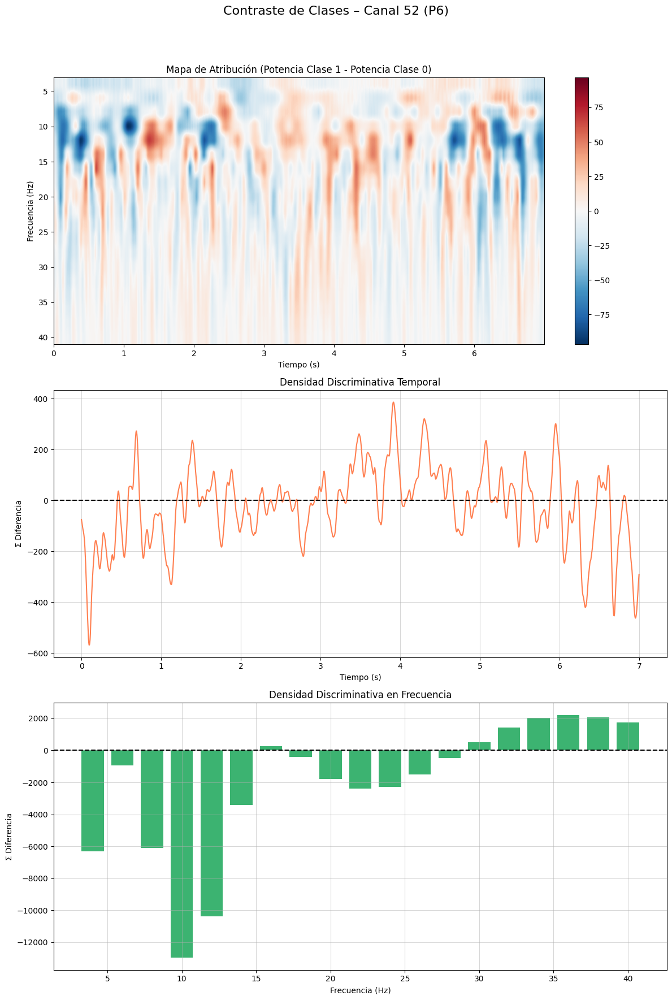


========= CANAL 53 (P8) / 63 =========


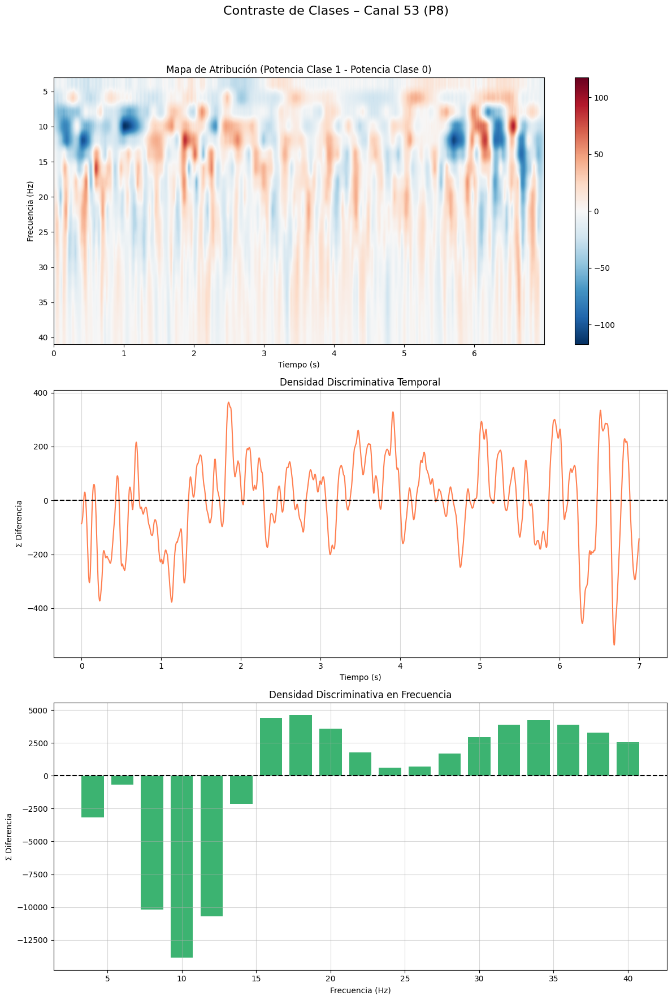


========= CANAL 54 (P10) / 63 =========


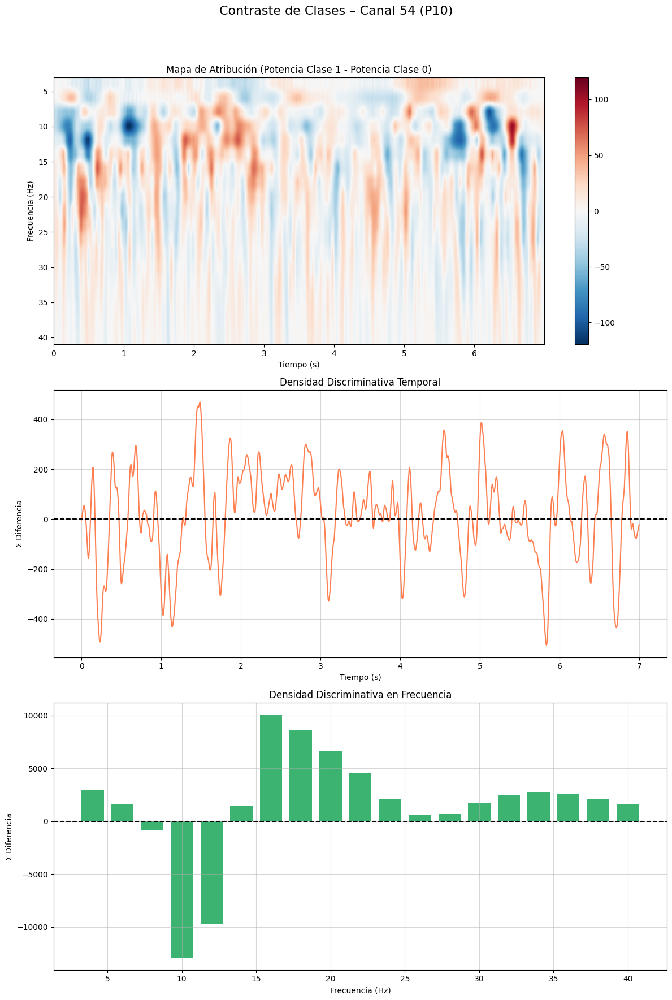


========= CANAL 55 (PO7) / 63 =========


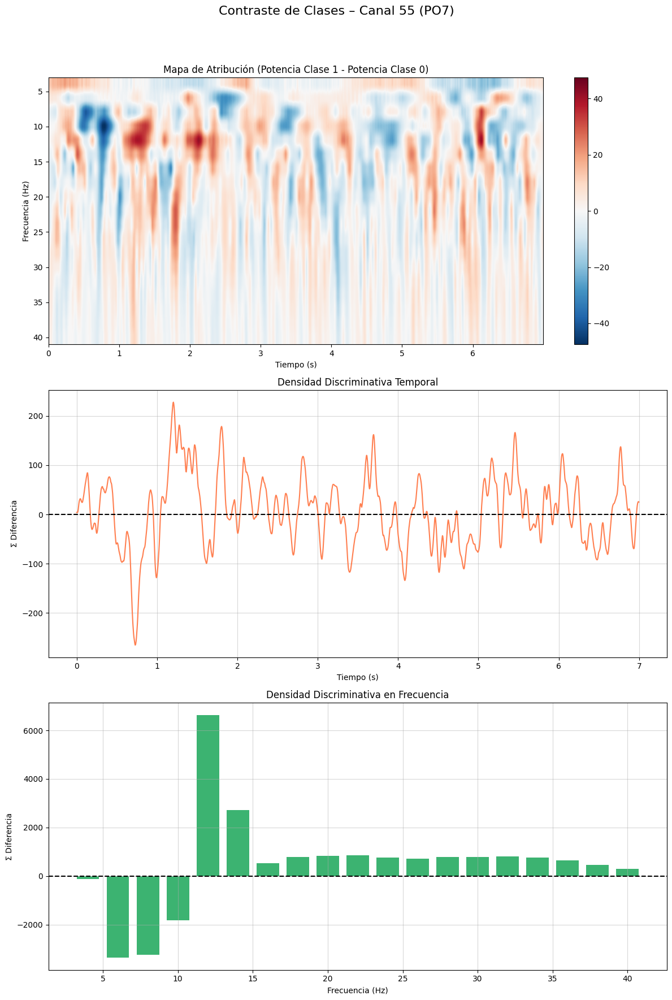


========= CANAL 56 (PO3) / 63 =========


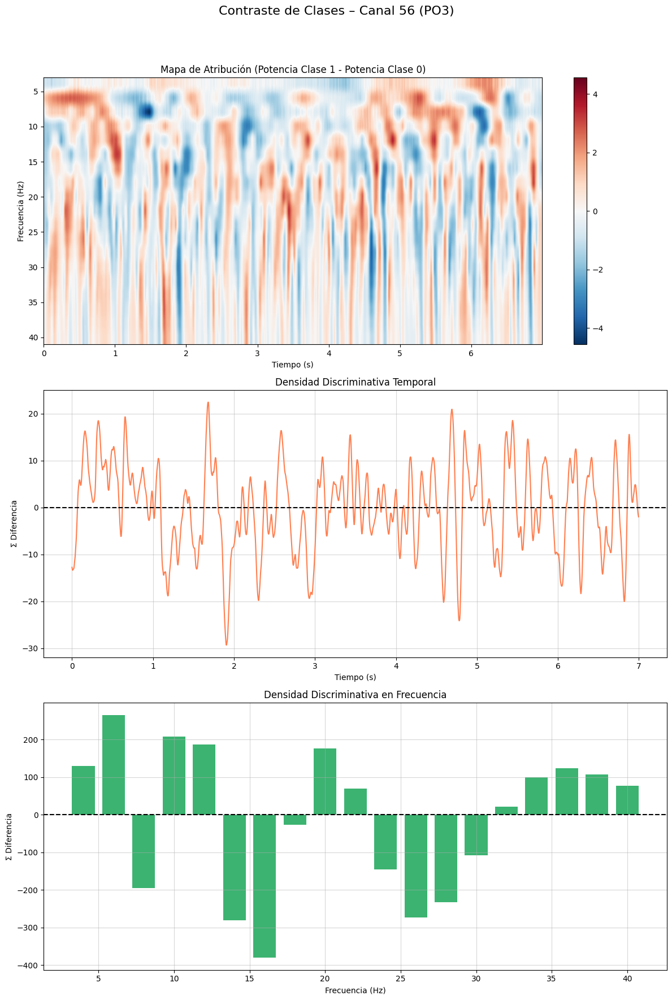


========= CANAL 57 (POz) / 63 =========


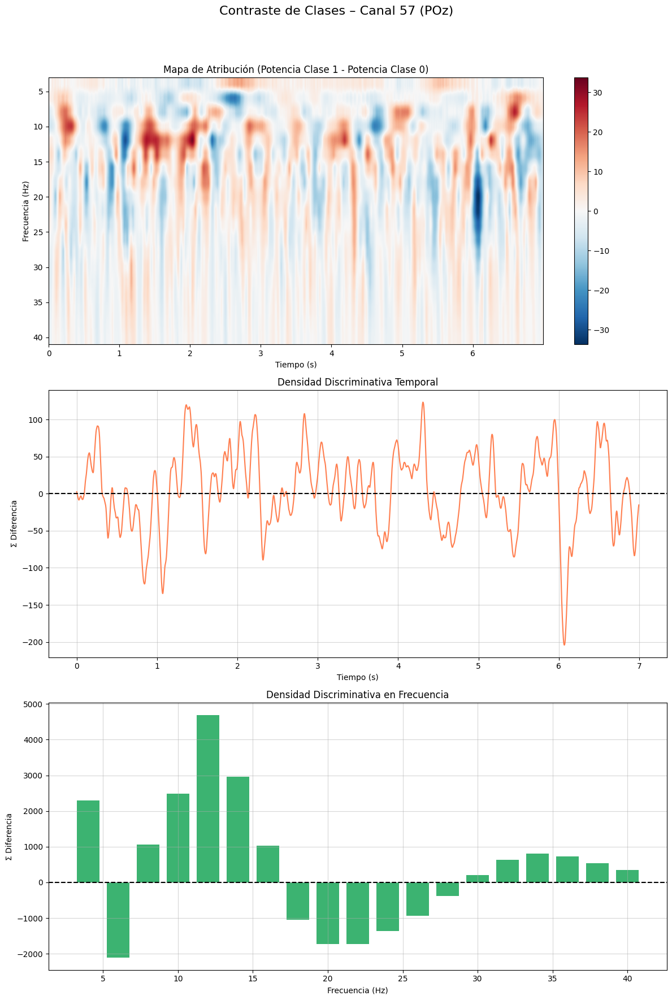


========= CANAL 58 (PO4) / 63 =========


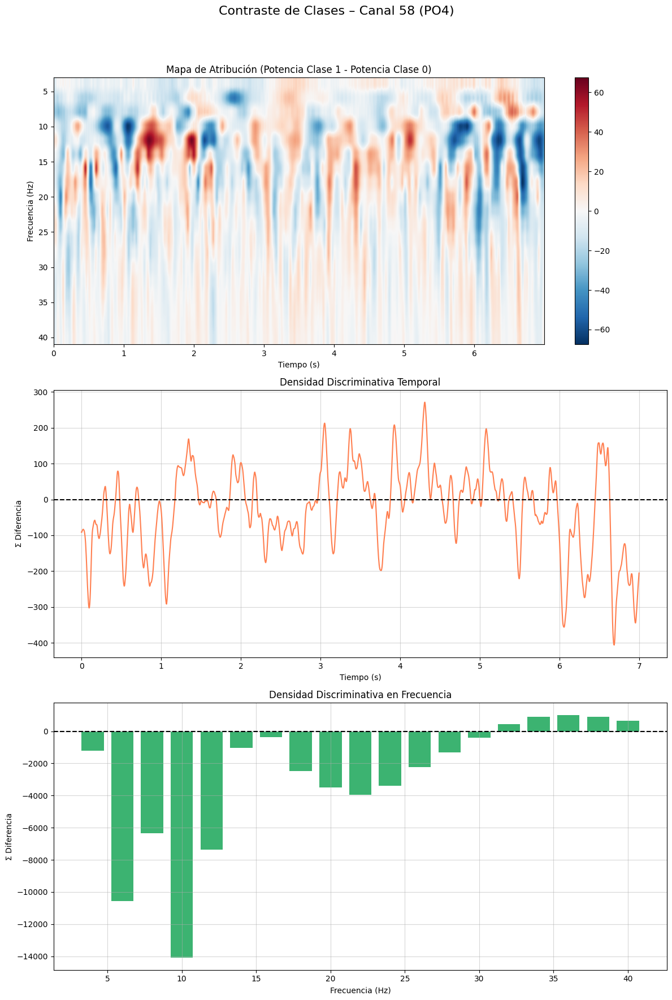


========= CANAL 59 (PO8) / 63 =========


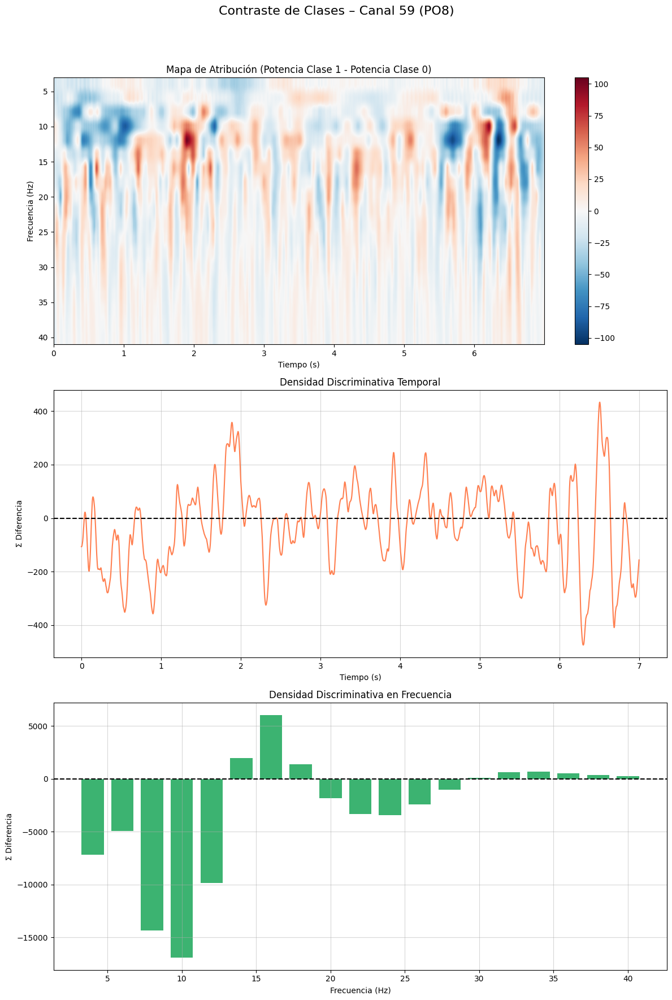


========= CANAL 60 (O1) / 63 =========


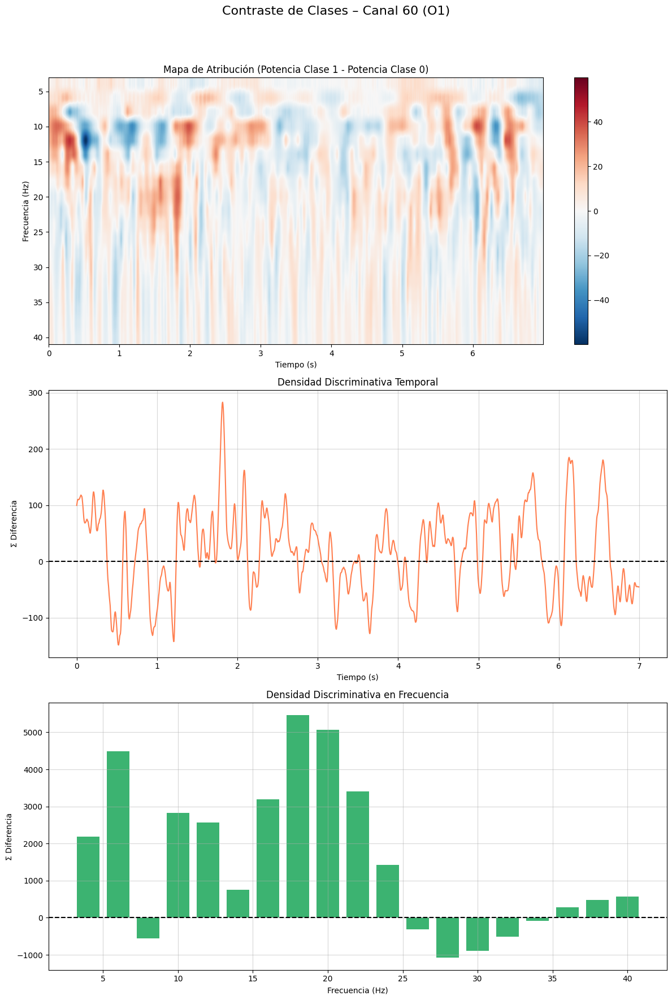


========= CANAL 61 (Oz) / 63 =========


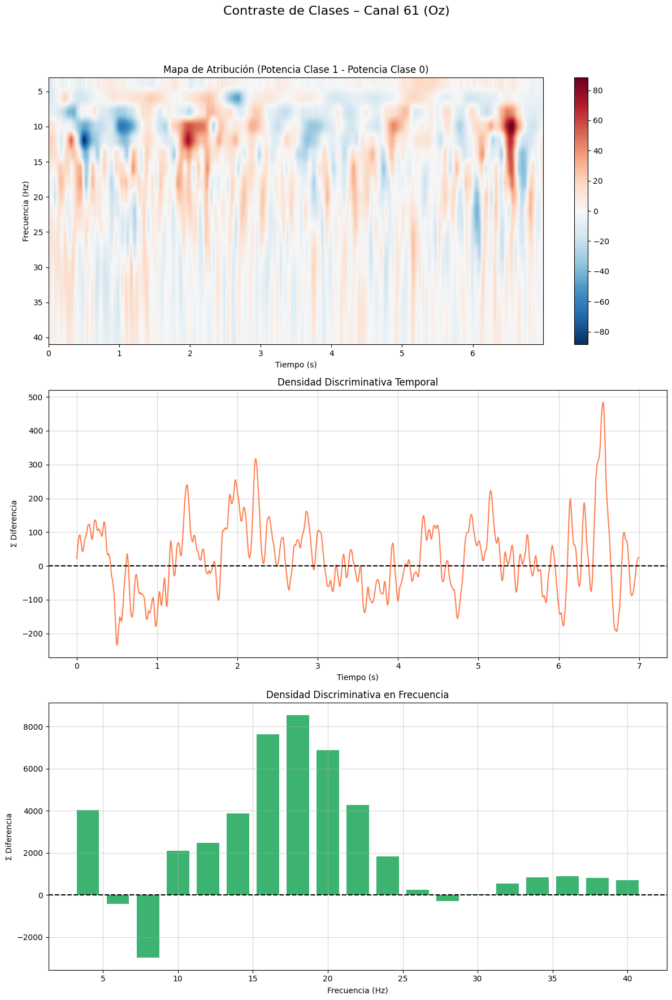


========= CANAL 62 (O2) / 63 =========


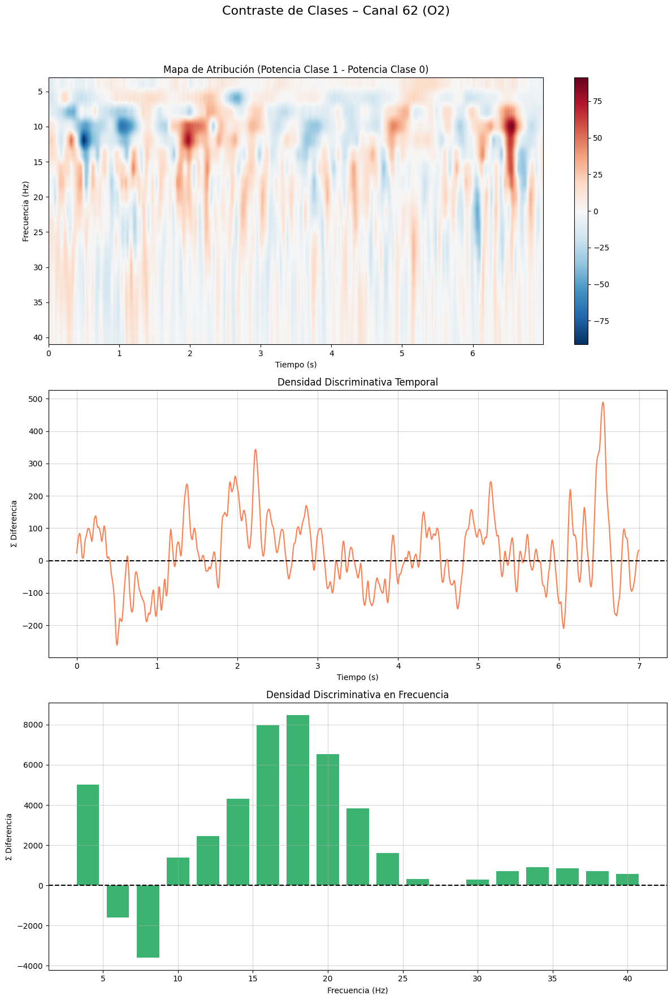


========= CANAL 63 (Iz) / 63 =========


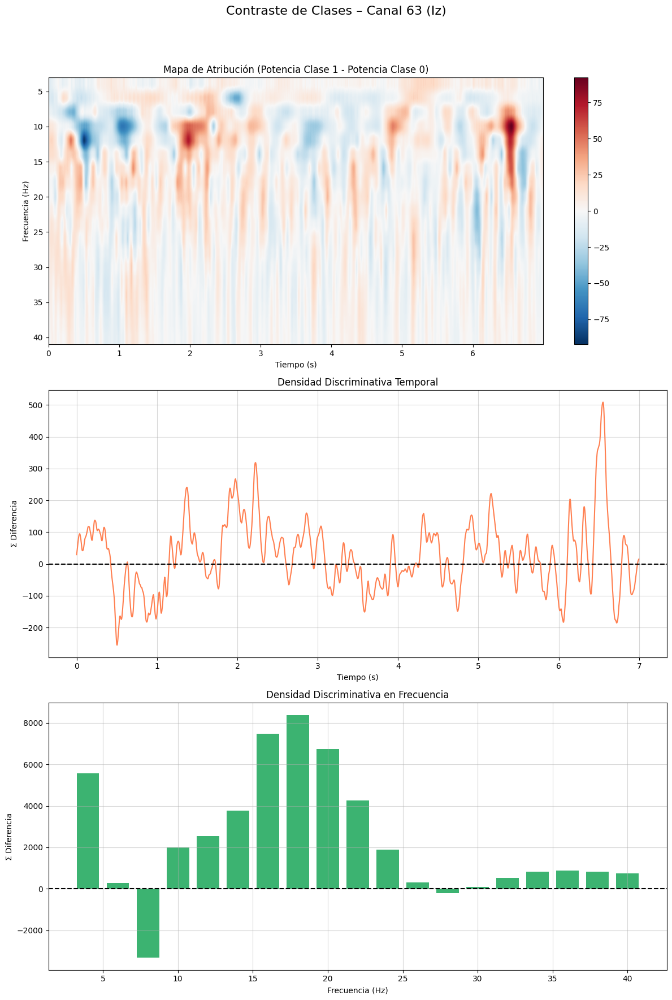


Análisis CWT por canal completado.


In [8]:
# ================================================================= #
#  CELL 6: INTERPRETACIÓN MÉTODO 1: CONTRASTE CWT POR CANAL         #
# ================================================================= #

print("\n\n=======================================================================")
print("INICIANDO FASE DE INTERPRETACIÓN - CONTRASTE DIRECTO CWT (COMPLEJA)")
print("=======================================================================")

X_train = X_tr
X_test = X_te
y_train = y_tr
y_test = y_te

# --- Definiciones básicas para CWT ---
n_channels = X_train.shape[1]
n_timesteps = X_train.shape[2]
sampling_rate = 250.0
wavelet_name = 'cmor1.5-1.0' # Wavelet Morlet Compleja
frequencies_to_analyze_cwt = np.arange(4, 41, 2)
scales = pywt.scale2frequency(wavelet_name, frequencies_to_analyze_cwt) / (1 / sampling_rate)
dtype_complex = np.complex64

def signal_to_wavelet(trial_data: np.ndarray) -> np.ndarray:
    """Calcula la CWT compleja para un único ensayo."""
    coeffs_all = []
    for channel_data in trial_data:
        coeffs, _ = pywt.cwt(channel_data, scales, wavelet_name)
        coeffs_all.append(coeffs.astype(dtype_complex))
    return np.array(coeffs_all, dtype=dtype_complex)

# --- Pre-cómputo de los mapas CWT para cada clase ---
print("\n--- Calculando CWT para todos los ensayos por clase (Coeficientes Complejos) ---")
X_train_class_0 = X_train[y_train == 0]
X_train_class_1 = X_train[y_train == 1]

print("Clase 0...")
wavelets_class_0 = np.array([signal_to_wavelet(tr) for tr in tqdm(X_train_class_0)], dtype=dtype_complex)
print("Clase 1...")
wavelets_class_1 = np.array([signal_to_wavelet(tr) for tr in tqdm(X_train_class_1)], dtype=dtype_complex)
gc.collect() # Liberar memoria tras crear los arreglos grandes

# --- Bucle de Contraste y Visualización por Canal ---
time_vector = np.arange(n_timesteps) / sampling_rate
for ch in range(n_channels):
    print(f"\n========= CANAL {ch} ({channels[ch]}) / {n_channels-1} =========")
    
    # Promedio de los mapas CWT complejos por clase
    avg_tf_map_c0 = np.mean(wavelets_class_0[:, ch, :, :], axis=0)
    avg_tf_map_c1 = np.mean(wavelets_class_1[:, ch, :, :], axis=0)
    
    # El mapa de atribución es la diferencia absoluta de las magnitudes
    attr_map = np.abs(avg_tf_map_c1) - np.abs(avg_tf_map_c0) # Diferencia de Potencia
    
    # Importancias marginales
    temporal_imp = np.sum(attr_map, axis=0)
    frequency_imp = np.sum(attr_map, axis=1)

    # Visualización
    fig, axes = plt.subplots(3, 1, figsize=(12, 18))
    fig.suptitle(f'Contraste de Clases – Canal {ch} ({channels[ch]})', fontsize=16)
    
    # Mapa de Atribución 2D
    vmax = np.max(np.abs(attr_map))
    im = axes[0].imshow(attr_map, extent=[time_vector[0], time_vector[-1], frequencies_to_analyze_cwt[-1]+1, frequencies_to_analyze_cwt[0]-1], aspect='auto', cmap='RdBu_r', vmin=-vmax, vmax=vmax)
    axes[0].set_ylabel('Frecuencia (Hz)'); axes[0].set_xlabel('Tiempo (s)'); axes[0].set_title('Mapa de Atribución (Potencia Clase 1 - Potencia Clase 0)')
    fig.colorbar(im, ax=axes[0])
    
    # Importancia Temporal
    axes[1].plot(time_vector, temporal_imp, color='coral'); axes[1].set_xlabel('Tiempo (s)'); axes[1].set_ylabel('Σ Diferencia'); axes[1].set_title('Densidad Discriminativa Temporal'); axes[1].grid(True, alpha=0.5); axes[1].axhline(0, color='black', linestyle='--')
    
    # Importancia de Frecuencia
    axes[2].bar(frequencies_to_analyze_cwt, frequency_imp, width=1.5, color='mediumseagreen'); axes[2].set_xlabel('Frecuencia (Hz)'); axes[2].set_ylabel('Σ Diferencia'); axes[2].set_title('Densidad Discriminativa en Frecuencia'); axes[2].grid(True, alpha=0.5); axes[2].axhline(0, color='black', linestyle='--')
    
    plt.tight_layout(rect=[0, 0, 1, 0.95]); plt.show()

print("\nAnálisis CWT por canal completado.")

#### **6.2. Método 2: Análisis Topográfico Tiempo-Frecuencia con MNE**

**Objetivo**: Superar la limitación del análisis por canal y obtener una visión holística de los patrones de actividad. Esta técnica nos permite visualizar cómo se distribuye la potencia discriminativa **a través de todo el cuero cabelludo**.

**Metodología**:
Este método aprovecha la potencia de la librería **MNE-Python**.

1.  **Configuración del Objeto `Info` de MNE**: MNE requiere un objeto `Info` que contenga metadatos esenciales: nombres de canales, frecuencia de muestreo y, lo más importante, las **posiciones 3D de los canales** (`montage`). El montaje `standard_1020` es lo que permite a MNE proyectar los datos sobre una cabeza modelo.
2.  **Creación de Objetos `Epochs`**: Se convierten los datos de NumPy al formato `EpochsArray` de MNE, que es la estructura de datos fundamental para representar ensayos segmentados.
3.  **Cálculo de la Representación Tiempo-Frecuencia (TFR)**: Se utiliza `mne.time_frequency.tfr_morlet`. Con `average=True`, MNE calcula eficientemente la potencia para cada ensayo y luego las promedia, resultando en un único objeto `AverageTFR` por clase.
4.  **Normalización Espacial (`normalize_spatially_inplace`)**: Este es un paso **crítico y sofisticado** para una visualización correcta.
    *   **Problema**: La potencia absoluta de las señales EEG varía enormemente entre regiones cerebrales (ej. la banda alfa en la corteza occipital es muy potente). Si se visualizan los valores de potencia en bruto, la escala de colores quedaría dominada por estas regiones de alta potencia, ocultando patrones más sutiles pero igualmente importantes en otras áreas.
    *   **Solución**: Esta función itera sobre cada punto tiempo-frecuencia. Para cada punto, toma el vector de valores de potencia a través de todos los canales y lo normaliza a un rango. Esto preserva la **distribución espacial relativa** de la potencia, permitiéndonos comparar qué áreas son más o menos activas *entre sí* en ese instante, en lugar de depender de sus valores absolutos.
5.  **Visualización Avanzada**:
    *   **Gráficos Lado a Lado**: Para obtener una figura profesional con una barra de color compartida, se sigue una técnica avanzada:
        1.  Se generan los gráficos topográficos de MNE con `show=False` y `colorbar=False`.
        2.  Se convierten estos gráficos en imágenes PNG en memoria.
        3.  Se utiliza `matplotlib.GridSpec` para crear un lienzo personalizado y colocar las dos imágenes una al lado de la otra, con una barra de color común dibujada manualmente debajo.
    *   **Visualización de la Diferencia**: Se utiliza `mne.combine_evoked` para restar el TFR normalizado de una clase del de la otra. El mapa resultante muestra directamente las regiones donde una clase tiene más potencia relativa que la otra (rojo: Clase 1 > Clase 0; azul: Clase 0 > Clase 1), utilizando un mapa de color divergente (`RdBu_r`) para una interpretación intuitiva.



INICIANDO ANÁLISIS TOPOGRÁFICO TIEMPO-FRECUENCIA (MNE)
Creados 80 Epochs para Clase 0 y 80 para Clase 1.

Calculando TFR trial‑by‑trial para Clase 0...
Calculando TFR trial‑by‑trial para Clase 1...
Aplicando normalización espacial sobre TFR de forma (64, 36, 1750)...
Aplicando normalización espacial sobre TFR de forma (64, 36, 1750)...

Generando visualizaciones normalizadas...


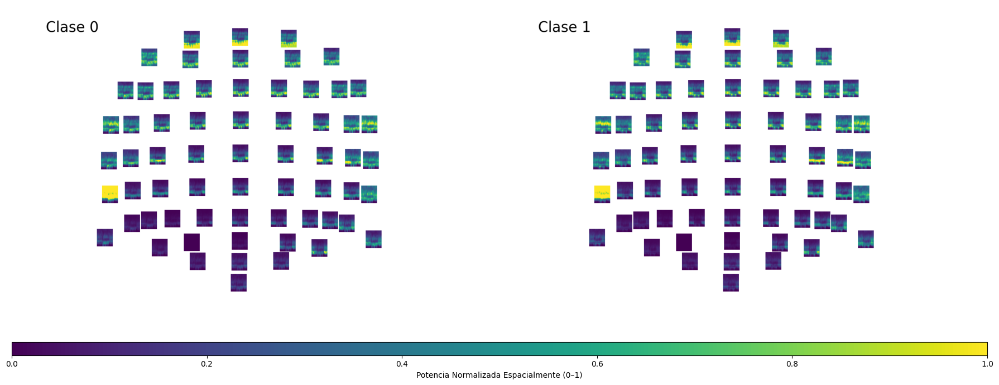

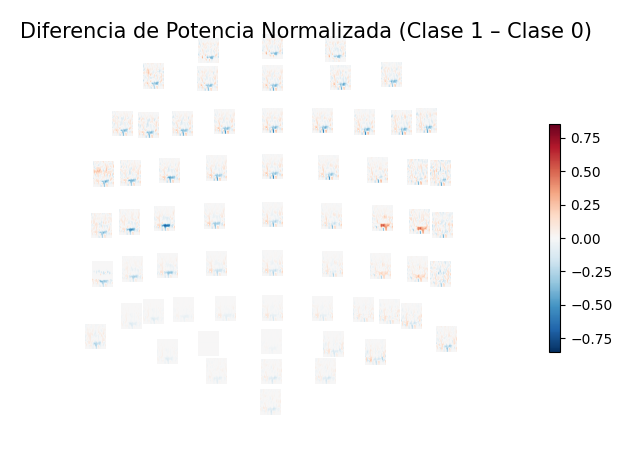

In [9]:
# ================================================================= #
#  CELL 7: INTERPRETACIÓN MÉTODO 2: ANÁLISIS TOPOGRÁFICO TFR        #
# ================================================================= #

print("\n\n=======================================================================")
print("INICIANDO ANÁLISIS TOPOGRÁFICO TIEMPO-FRECUENCIA (MNE)")
print("=======================================================================")

# --- PASO 0: DEFINICIONES Y PREPARACIÓN DEL ENTORNO MNE ---
n_channels = X_train.shape[1]
sampling_rate = 250.0
frequencies_to_analyze = np.arange(4, 40, 1)

ch_names = channels
ch_types = ['eeg'] * n_channels
info = mne.create_info(ch_names=ch_names, sfreq=sampling_rate, ch_types=ch_types)
montage = mne.channels.make_standard_montage('standard_1020')
info.set_montage(montage)

# --- PASO 1: CREAR OBJETOS EPOCHS DE MNE ---
epochs_class_0 = mne.EpochsArray(X_train[y_train == 0], info)
epochs_class_1 = mne.EpochsArray(X_train[y_train == 1], info)

print(f"Creados {len(epochs_class_0)} Epochs para Clase 0 y {len(epochs_class_1)} para Clase 1.")

# --- PASO 2: CALCULAR TFR TRIAL‑BY‑TRIAL Y LUEGO PROMEDIAR ---
print("\nCalculando TFR trial‑by‑trial para Clase 0...")
tfrs_0 = mne.time_frequency.tfr_morlet(
    epochs_class_0, freqs=frequencies_to_analyze, n_cycles=frequencies_to_analyze / 2.,
    use_fft=True, average=False, return_itc=False
)

print("Calculando TFR trial‑by‑trial para Clase 1...")
tfrs_1 = mne.time_frequency.tfr_morlet(
    epochs_class_1, freqs=frequencies_to_analyze, n_cycles=frequencies_to_analyze / 2.,
    use_fft=True, average=False, return_itc=False
)

# Promediamos las potencias resultantes para obtener el mapa de potencia promedio por clase
tfr_class_0 = tfrs_0.average()
tfr_class_1 = tfrs_1.average()

# --- PASO 3: APLICAR NORMALIZACIÓN ESPACIAL (LÓGICA CORREGIDA) ---
def normalize_spatially_inplace(tfr_object):
    # ... (el código de la función está bien documentado internamente)
    print(f"Aplicando normalización espacial sobre TFR de forma {tfr_object.data.shape}...")
    normalized_tfr = tfr_object.copy() # Copia para no modificar el objeto original
    tfr_data = normalized_tfr.data
    n_ch, n_freqs, n_times = tfr_data.shape
    for f_idx in range(n_freqs):
        for t_idx in range(n_times):
            spatial_slice = tfr_data[:, f_idx, t_idx]
            min_val, max_val = np.min(spatial_slice), np.max(spatial_slice)
            if max_val - min_val > 1e-9:
                normalized_slice = (spatial_slice - min_val) / (max_val - min_val)
            else:
                normalized_slice = np.full_like(spatial_slice, 0.5)
            tfr_data[:, f_idx, t_idx] = normalized_slice
    return normalized_tfr

normalized_tfr_class_0 = normalize_spatially_inplace(tfr_class_0)
normalized_tfr_class_1 = normalize_spatially_inplace(tfr_class_1)

# --- PASO 4: VISUALIZACIÓN DE LOS DATOS NORMALIZADOS ---
print("\nGenerando visualizaciones normalizadas...")

# ... (el código utiliza io, ScalarMappable, Normalize y GridSpec para crear la figura final)
# 1) Figuras MNE completas, pero SIN colorbar y SIN mostrarlas aún
fig0 = normalized_tfr_class_0.plot_topo(
    title='Clase 0', fig_facecolor='w', font_color='k', border='none',
    cmap='viridis', vmin=0.0, vmax=1.0, colorbar=False, show=False
)
fig1 = normalized_tfr_class_1.plot_topo(
    title='Clase 1', fig_facecolor='w', font_color='k', border='none',
    cmap='viridis', vmin=0.0, vmax=1.0, colorbar=False, show=False
)
# 2) Convertimos cada figura en imagen PNG en memoria
def fig_to_array(fig, dpi=200): # ... (función auxiliar)
    buf = io.BytesIO(); fig.savefig(buf, format='png', dpi=dpi, bbox_inches='tight'); buf.seek(0); return plt.imread(buf)
img0 = fig_to_array(fig0); img1 = fig_to_array(fig1); plt.close('all')
# 3) Lienzo final
fig_side = plt.figure(figsize=(18, 7)); gs = fig_side.add_gridspec(2, 2, height_ratios=[25, 1])
ax0 = fig_side.add_subplot(gs[0, 0]); ax0.imshow(img0); ax0.axis('off')
ax1 = fig_side.add_subplot(gs[0, 1]); ax1.imshow(img1); ax1.axis('off')
cax = fig_side.add_subplot(gs[1, :]); sm = ScalarMappable(norm=Normalize(vmin=0, vmax=1), cmap='viridis')
cbar = fig_side.colorbar(sm, cax=cax, orientation='horizontal'); cbar.set_label('Potencia Normalizada Espacialmente (0–1)')
plt.tight_layout(); plt.show()

# --- VISUALIZAR LA DIFERENCIA (sin cambios) ---
diff_tfr_norm = mne.combine_evoked([normalized_tfr_class_1, normalized_tfr_class_0], weights=[1, -1])
vmax = np.max(np.abs(diff_tfr_norm.data)); vmin = -vmax

diff_tfr_norm.plot_topo(
    title='Diferencia de Potencia Normalizada (Clase 1 – Clase 0)',
    fig_facecolor='w', font_color='k', border='none',
    cmap='RdBu_r', vmin=vmin, vmax=vmax, colorbar=True
)
plt.show()

### **7. Conclusiones y Próximos Pasos**

Este cuaderno ha demostrado un pipeline de extremo a extremo para la clasificación de imaginería motora, culminando en un análisis de interpretabilidad profundo y neurofisiológicamente relevante.

**Resultados Clave**:
*   El modelo EEGNet ha sido entrenado exitosamente, alcanzando un nivel de precisión cuantificable en la tarea de clasificación.
*   El análisis de contraste por CWT ha identificado los canales, frecuencias y ventanas temporales específicas que contienen la mayor cantidad de información discriminativa.
*   El análisis topográfico con MNE ha proporcionado una visión holística de los patrones cerebrales, validando y contextualizando los hallazgos del análisis por canal. Por ejemplo, es común observar una disminución de la potencia en las bandas alfa/beta sobre la corteza motora contralateral a la mano imaginada (un fenómeno conocido como *Event-Related Desynchronization* o ERD).

**Próximos Pasos Sugeridos**:
1.  **Análisis Inter-Sujeto**: Extender este análisis a toda la base de datos para evaluar la variabilidad entre sujetos y construir modelos más generalizables.
2.  **XAI Basado en el Modelo**: Implementar técnicas de XAI que consulten directamente al modelo (ej. LIME, SHAP) y comparar sus resultados con los análisis de datos directos presentados aquí.
3.  **Implementación de propuesta AMDA-W-SHAP**: Implementar con exito propuesta de interpretabilidad multidominio.